In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys 
sys.path.append("/n/home12/binxuwang/Github/DiffusionReasoning")
from tensorboard_utils import extract_all_runs, extract_tensorboard_data_from_run, extract_last_step_summary

In [3]:
import os
import numpy as np
import pandas as pd
import torch
from os.path import join
import pickle as pkl
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm.autonotebook import trange, tqdm

/tmp/ipykernel_3737493/464873755.py:9: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import trange, tqdm


### Paths

In [4]:
tabdir = "/n/home12/binxuwang/Github/DiffusionReasoning/Tables"
# figdir = "/n/home12/binxuwang/Github/DiffusionReasoning/Figures_newrule"

GPT_exproot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/GPT2_raven"
DiT_exproot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results"
SiT_exproot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results"
SSM_exproot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/Mamba_raven"
EDM_exproot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/mini_edm/exps"

In [5]:
figroot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning"
GPTfigdir = join(figroot, "GPT2_raven")
EDMfigdir = join(figroot, "EDM_raven")
DiTfigdir = join(figroot, "DiT_raven")
SSMfigdir = join(figroot, "SSM_raven")
SiTfigdir = join(figroot, "SiT_raven")

In [6]:
import pandas as pd
# Set the maximum column width to 100 characters
pd.set_option('display.max_colwidth', 100)

In [7]:
!mkdir  /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/GPT2_raven
!mkdir  /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/EDM_raven
!mkdir  /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/DiT_raven
!mkdir  /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/SSM_raven
!mkdir  {SiTfigdir}


mkdir: cannot create directory ‘/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/GPT2_raven’: File exists
mkdir: cannot create directory ‘/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/EDM_raven’: File exists
mkdir: cannot create directory ‘/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/DiT_raven’: File exists
mkdir: cannot create directory ‘/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/SSM_raven’: File exists
mkdir: cannot create directory ‘/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/SiT_raven’: File exists


In [8]:
figdir = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/Figure_memorization_inspection"

### Util functions for Rule learning dynamics 

Function to parse the experiment string

In [9]:
import re
def extract_and_convert(string):
    """Simple function to extract pattern like stream0_16 or stream16M and convert to float 0.16 or integer 16"""
    # Pattern to match the "0_16" part and convert to float 0.16
    match1 = re.search(r'stream(\d+)_(\d+)', string)
    if match1:
        num1 = str(match1.group(1))
        num2 = str(match1.group(2))
        result = float(f"{num1}.{num2}")
        return result
    
    # Pattern to match the "16M" part and convert to integer 16
    match2 = re.search(r'stream(\d+)M', string)
    if match2:
        result = int(match2.group(1))
        return result
    
    return None

Functions to load the samples and eval stats, plot the data

In [10]:
def sweep_collect_eval_data(expname, exproot, prefix=None):
    assert os.path.exists(join(exproot, expname, "samples")), expname  
    # print(sorted(os.listdir(join(exproot, expname, "samples"))))
    print(f"Extracted data from {join(exproot, expname, 'samples')}")
    print(f"example file:", os.listdir(join(exproot, expname, 'samples'))[0])
    # for files with names like 'sample_rule_eval_995000.pt' find the one with largest number
    epoch_nums = sorted([int(f.split(prefix)[-1].split(".pt")[0]) for f in os.listdir(join(exproot, expname,'samples')) if prefix in f])
    eval_col = {}
    for epoch_num in tqdm(epoch_nums):
        samples_eval = torch.load(join(exproot, expname, 'samples', f"{prefix}{epoch_num}.pt"))
        eval_col[epoch_num] = samples_eval
    return eval_col

In [11]:
def extract_rule_list_from_eval_col(eval_col, is_abinit = False):
    epoch_list = sorted(list(eval_col.keys()))
    rule_list_all = []
    consistency_all = []
    for epoch in eval_col.keys():
        if is_abinit:
            rule_list_all.append(eval_col[epoch]['rule_col_list_abinit'])
            consistency_all.append((eval_col[epoch]['C3_list_abinit'], eval_col[epoch]['C2_list_abinit']))
        else:
            rule_list_all.append(eval_col[epoch]['rule_col_list'])
            consistency_all.append((eval_col[epoch]['C3_list'], eval_col[epoch]['C2_list']))
    rule_list_all = np.array(rule_list_all, dtype=object)
    consistency_all = np.array(consistency_all, dtype=object)
    print(rule_list_all.shape, consistency_all.shape)
    return epoch_list, rule_list_all, consistency_all


def extract_rule_list_from_eval_col_Diffusion(eval_col, ):
    print("diffusion model, just fetch ab init generation")
    epoch_list = sorted(list(eval_col.keys()))
    rule_list_all = []
    consistency_all = []
    for epoch in eval_col.keys():
        rule_list_all.append(eval_col[epoch]['rule_col'])
        consistency_all.append((eval_col[epoch]['c3_list'], eval_col[epoch]['c2_list']))

    rule_list_all = np.array(rule_list_all, dtype=object)
    consistency_all = np.array(consistency_all, dtype=object)
    print(rule_list_all.shape, consistency_all.shape)
    return epoch_list, rule_list_all, consistency_all

In [12]:
def format_rule_list_to_mat(rule_list_all, consistency_all):
    """Format the collected rule_list_all and consistency_all into rule_cnt_mat, cons3_rule_cnt_mat, cons2_rule_cnt_mat.
    for plotting purposes.

    Args:
        rule_list_all: np.array, dtype object, shape=(num_epoch, num_sample, 3). 
        consistency_all: np.array, dtype object, shape=(num_epoch, 2, num_sample). 
                    where the 2nd dimension is the consistency of C3 and C2 rules corrspondingly. 

    Returns:
        rule_cnt_mat: np.array, shape=(num_epoch, 40). 
        cons3_rule_cnt_mat: np.array, shape=(num_epoch, 40). 
        cons2_rule_cnt_mat: np.array, shape=(num_epoch, 40).
    """
    epoch_num = rule_list_all.shape[0]
    rule_pool_all = []
    for i in range(epoch_num): # trange
        rule_pool = np.concatenate(list(rule_list_all[i,:,:].flatten())).astype(int)
        rule_pool_all.append(rule_pool)
    # plot the number of rules == rule_i for each generation
    rule_cnt_mat = np.zeros((epoch_num, 40))
    for i in range(epoch_num): # trange
        rule_pool = rule_pool_all[i]
        rule_uniq, counts = np.unique(rule_pool, return_counts=True)
        rule_cnt_mat[i, rule_uniq] = counts

    cons3_rule_pool_all = []
    cons2_rule_pool_all = []
    for i in range(epoch_num): # trange
        rule_pool = np.concatenate(list(consistency_all[i,0,:].flatten())).astype(int)
        cons3_rule_pool_all.append(rule_pool)
        rule_pool = np.concatenate(list(consistency_all[i,1,:].flatten())).astype(int)
        cons2_rule_pool_all.append(rule_pool)

    cons3_rule_cnt_mat = np.zeros((epoch_num, 40))
    cons2_rule_cnt_mat = np.zeros((epoch_num, 40))
    for i in range(epoch_num): # trange
        rule_pool = cons3_rule_pool_all[i]
        rule_uniq, counts = np.unique(rule_pool, return_counts=True)
        cons3_rule_cnt_mat[i, rule_uniq] = counts
        rule_pool = cons2_rule_pool_all[i]
        rule_uniq, counts = np.unique(rule_pool, return_counts=True)
        cons2_rule_cnt_mat[i, rule_uniq] = counts
    return rule_cnt_mat, cons3_rule_cnt_mat, cons2_rule_cnt_mat

In [14]:
from rule_new_utils import rule_table, relation_dict, attribute_dict
from circuit_toolkit.plot_utils import saveallforms
def visualize_indiv_rule_dynam(epoch_list, rule_mat, conv_wid=10, heldout_id=[1, 16, 20, 34, 37],
                               titlestr="Valid rule count separated by rule type", ylabel="Count", axs=None):
    # remove top and right spines from plot with plt
    plt.rcParams.update({'font.size': 12})
    if axs is None:
        figh, axs = plt.subplots(4, 10, figsize=(30, 12.5), sharex=True, sharey=True)
    else:
        figh = axs[0,0].get_figure()
    axs_f = axs.flatten()
    for i in range(40):
        ax = axs_f[i]
        # smooth the curve
        smooth_rule_cnt = np.convolve(rule_mat[:,i], np.ones(conv_wid)/conv_wid, mode='same')
        ax.plot(epoch_list, smooth_rule_cnt, alpha=0.7, )
        ax.set_title(f"R{i}: {rule_table[i]}")
        # change the font color of title to red
        if i in heldout_id:
            ax.title.set_color('red')
        if i >= 30:
            ax.set_xlabel("generation")
        if i % 10 == 0:
            ax.set_ylabel(ylabel)
    figh.suptitle(titlestr, fontsize=20)
    figh.tight_layout()
    figh.show()
    return figh, axs

In [15]:
def visualize_train_heldout_rule(epoch_list, plot_mat, heldout_id, 
                                 normalizer=None, titlestr="", 
                                 reflevel=None):#conv_wid=10, axs=None):
    heldout_mask = np.zeros((40,)).astype(bool)
    heldout_mask[heldout_id] = True
    if normalizer is not None:
        plot_mat = plot_mat / normalizer
    figh, axs = plt.subplots(1, 2, figsize=(11, 5), sharey=True)
    plt.subplot(1, 2, 1)
    plt.plot(epoch_list, plot_mat[:, ~heldout_mask], alpha=0.4)
    plt.plot(epoch_list, plot_mat[:, ~heldout_mask].mean(axis=1), color='black', linewidth=2)
    if reflevel is not None:
        plt.axhline(y=reflevel, color='r', linestyle='--')
    plt.subplot(1, 2, 2)
    plt.plot(epoch_list, plot_mat[:, heldout_mask], alpha=0.4)
    plt.plot(epoch_list, plot_mat[:, heldout_mask].mean(axis=1), color='black', linewidth=2)
    if reflevel is not None:
        plt.axhline(y=reflevel, color='r', linestyle='--')
    plt.suptitle(titlestr) # "Accuracy of C3 for each rule type"
    plt.show()
    return figh

## SiT

In [13]:
syndf_SiT = pd.read_csv(join(tabdir, "SiT_raven_tensorboard_data.csv"), index_col=0)
tb_data_col_SiT = pkl.load(open(join(tabdir, "SiT_raven_tensorboard_raw_data.pkl"), "rb"))

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/004-SiT_S_1-stream0_16M_pilot-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/351 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(351, 2048, 3) (351, 2, 2048)
004-SiT_S_1-stream0_16M_pilot-Linear-velocity-None


/tmp/ipykernel_3737493/2629085931.py:16: RuntimeWarning: Mean of empty slice.
  plt.plot(epoch_list, plot_mat[:, heldout_mask].mean(axis=1), color='black', linewidth=2)


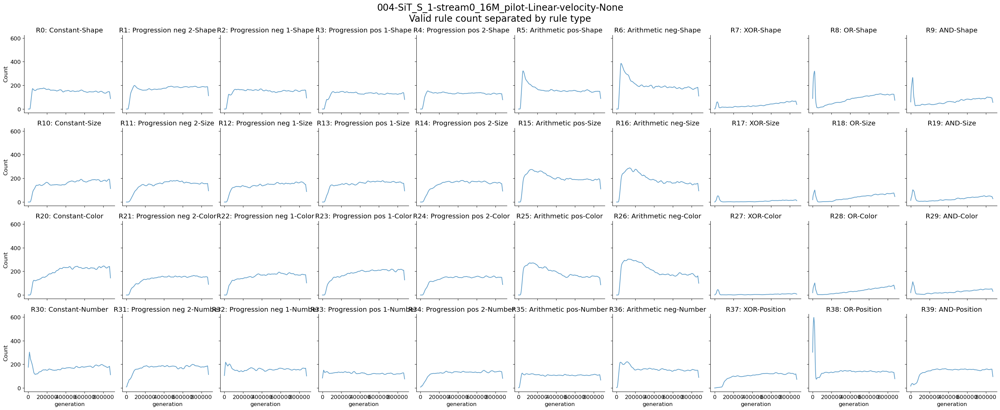

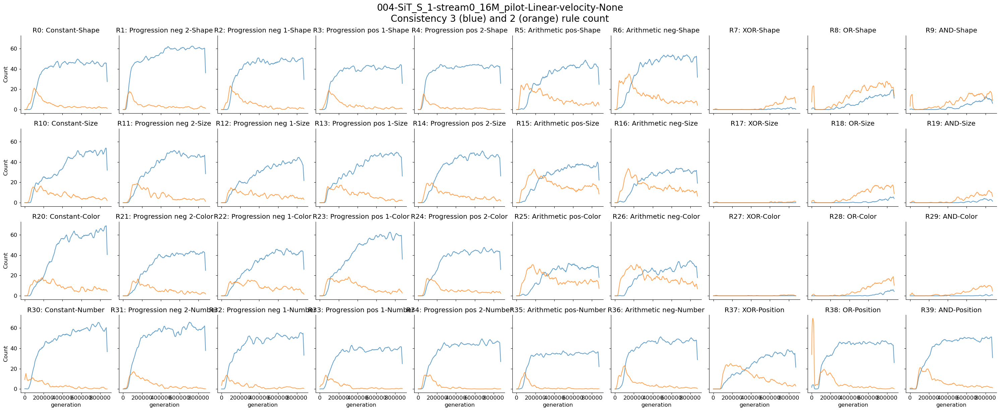

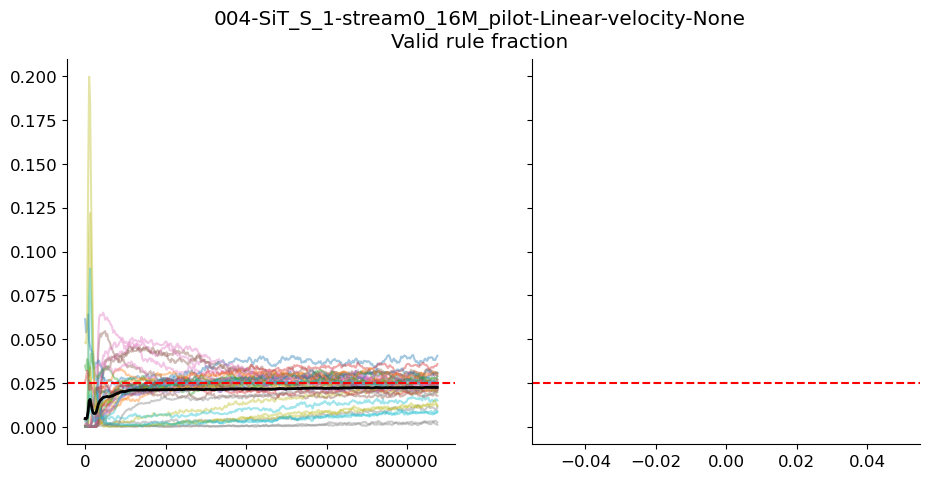

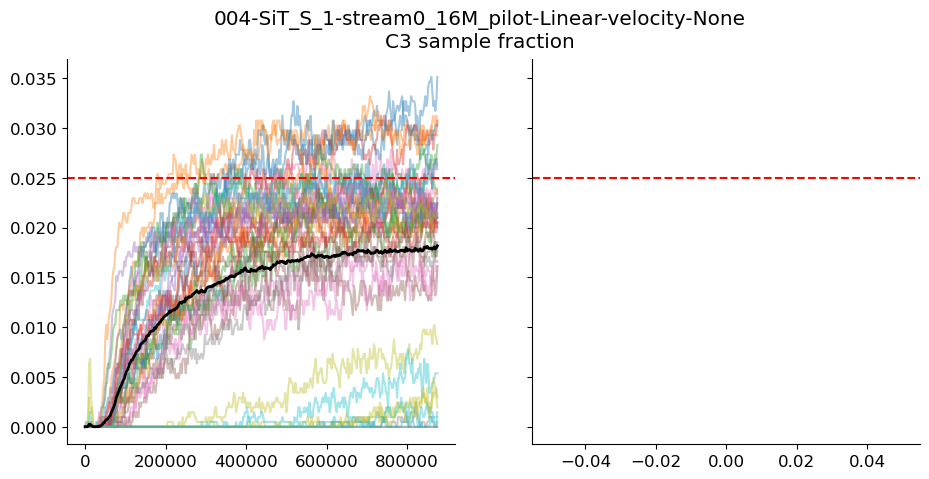

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/005-SiT_B_1-stream0_16M_pilot-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/351 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(351, 2048, 3) (351, 2, 2048)
005-SiT_B_1-stream0_16M_pilot-Linear-velocity-None


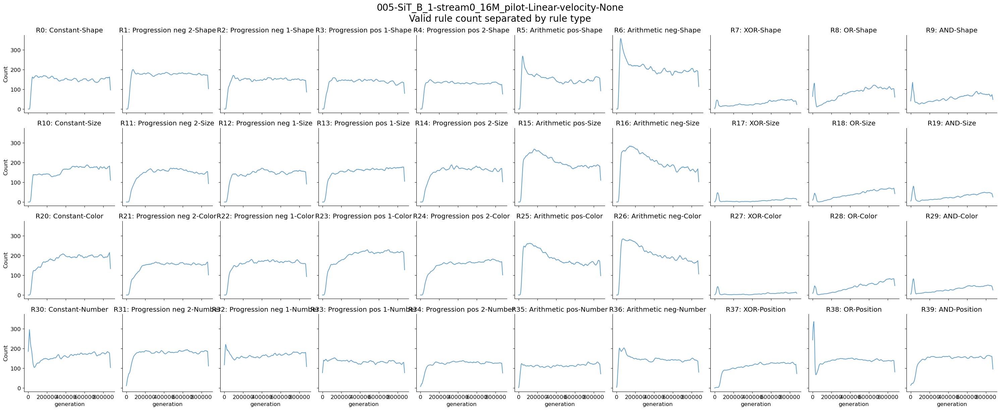

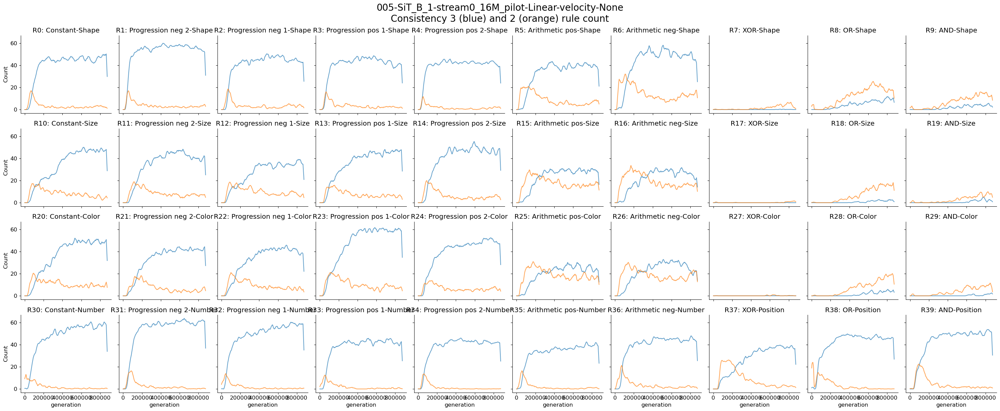

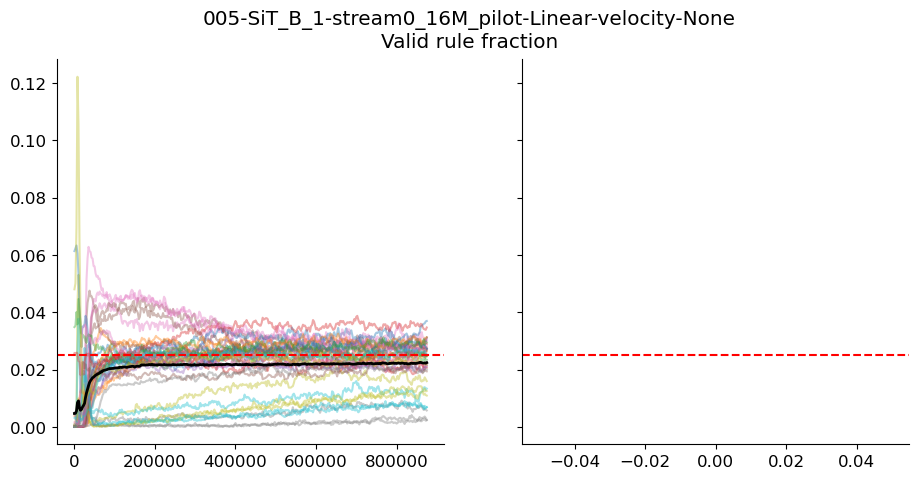

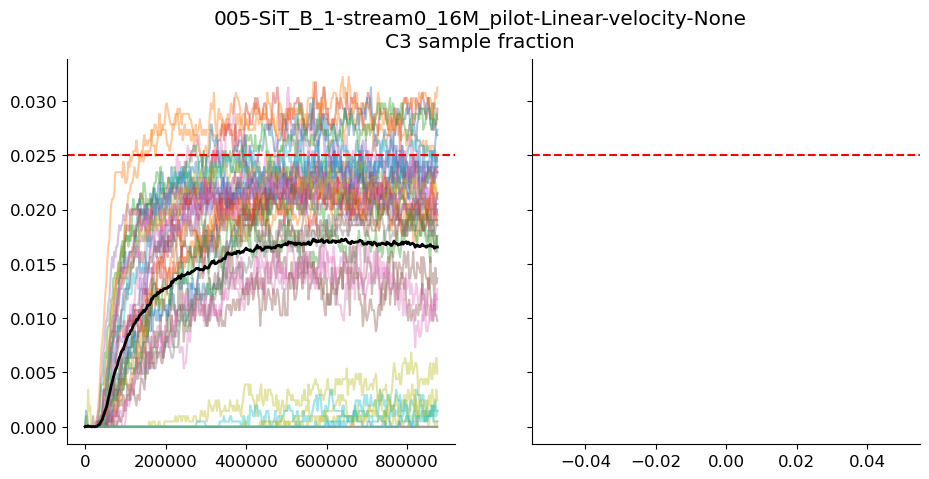

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/006-SiT_S_1-stream0_016M_all-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/402 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(402, 2048, 3) (402, 2, 2048)
006-SiT_S_1-stream0_016M_all-Linear-velocity-None


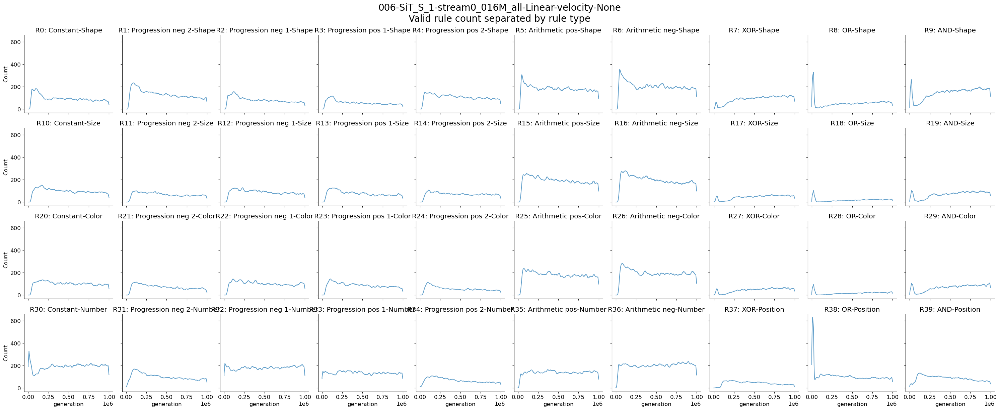

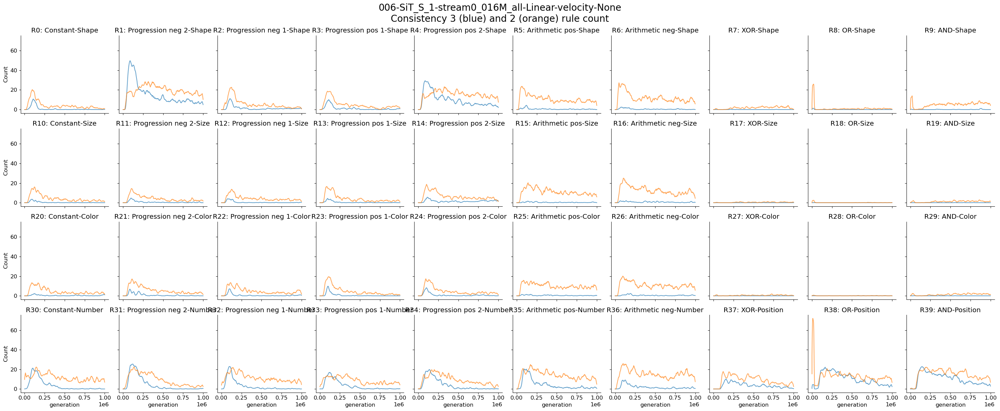

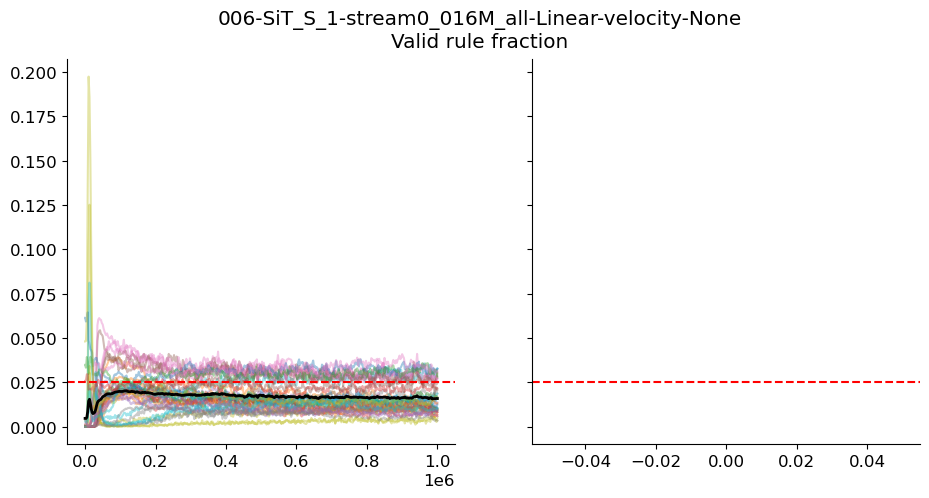

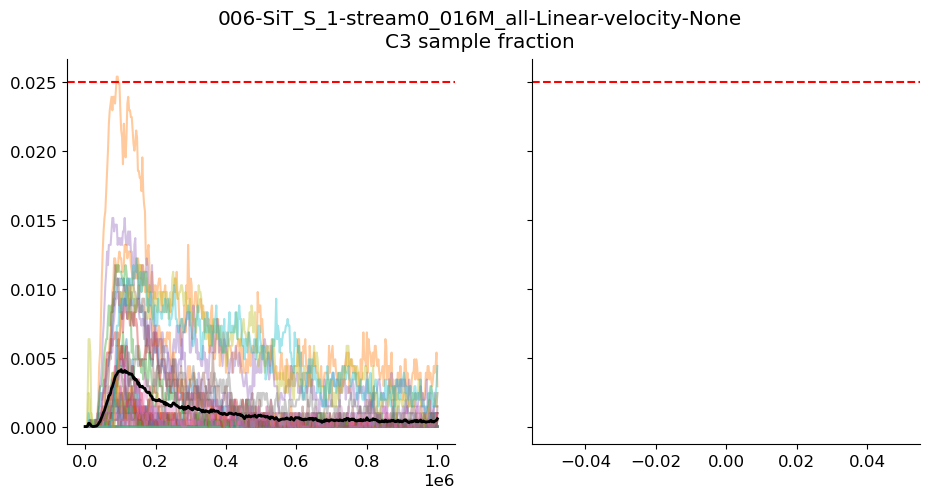

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/007-SiT_S_1-stream0_16M_all-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/402 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(402, 2048, 3) (402, 2, 2048)
007-SiT_S_1-stream0_16M_all-Linear-velocity-None


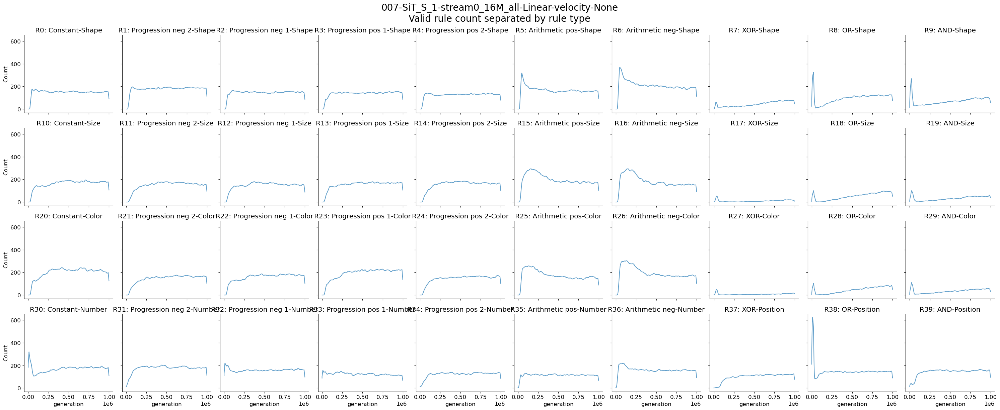

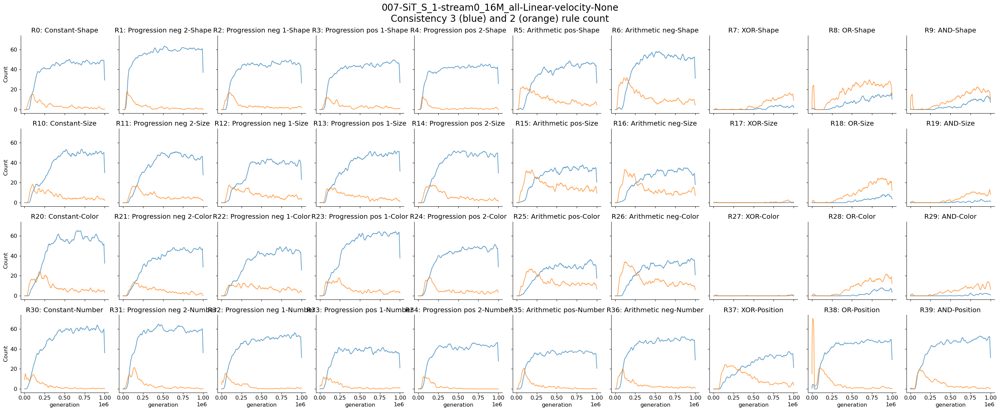

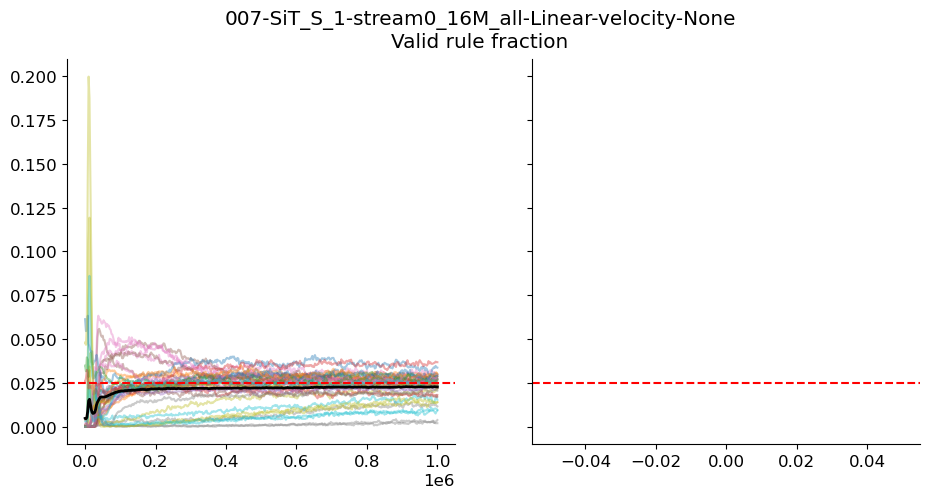

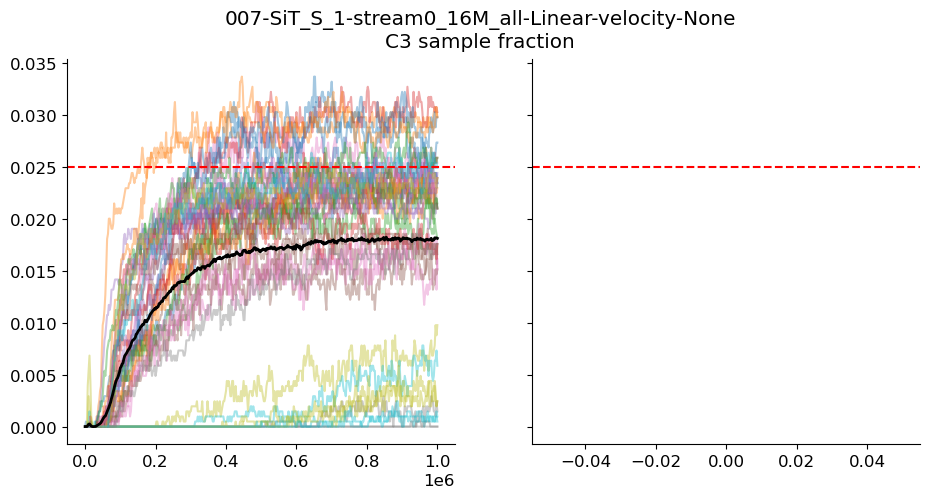

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/008-SiT_S_1-stream1_6M_all-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/402 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(402, 2048, 3) (402, 2, 2048)
008-SiT_S_1-stream1_6M_all-Linear-velocity-None


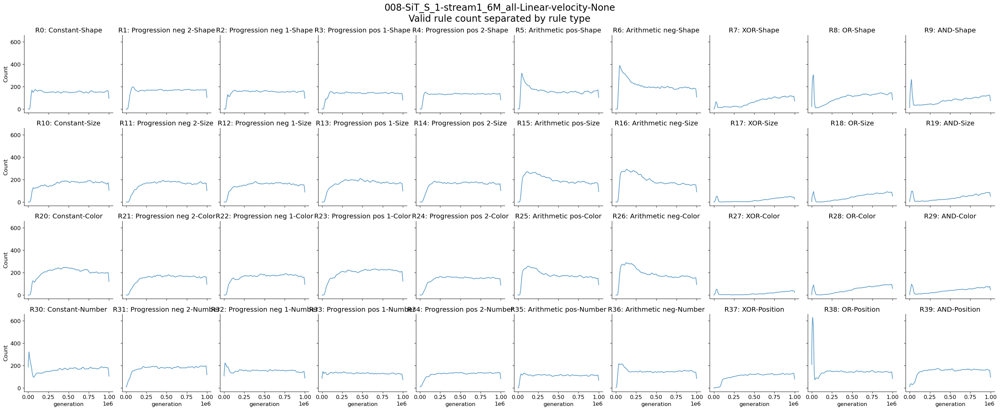

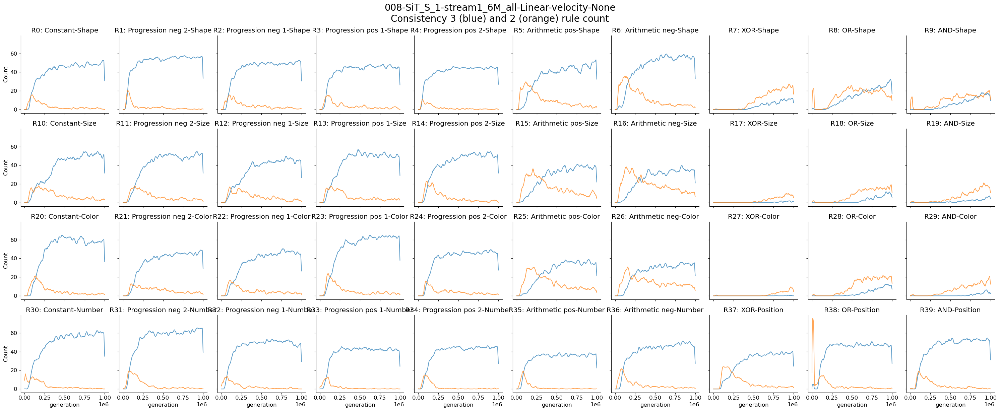

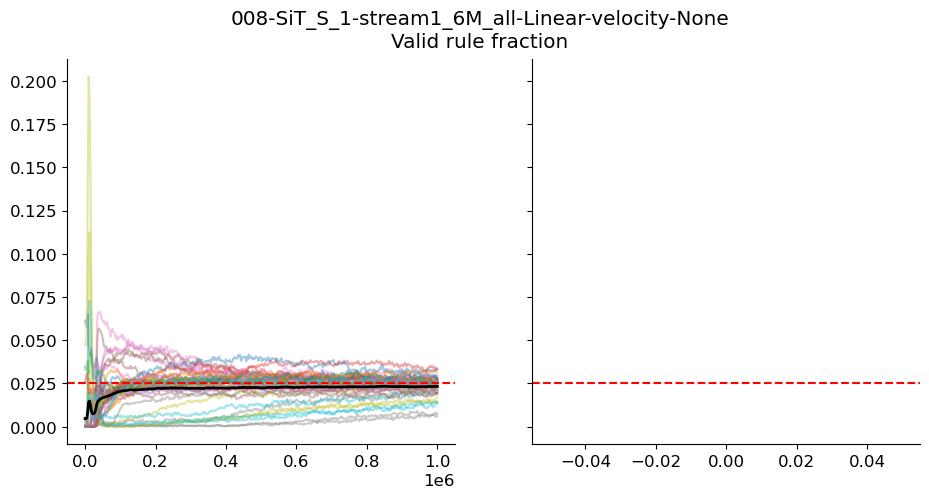

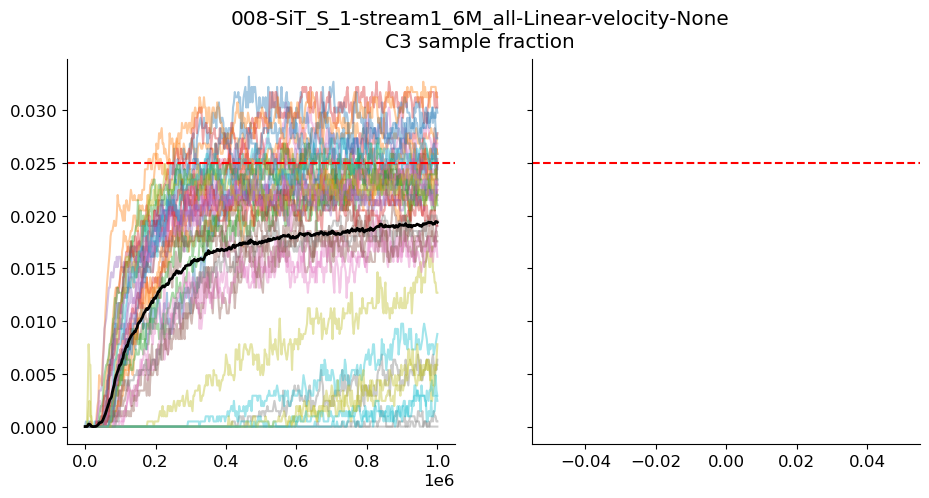

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/010-SiT_S_1-stream16M_all-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/402 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(402, 2048, 3) (402, 2, 2048)
010-SiT_S_1-stream16M_all-Linear-velocity-None


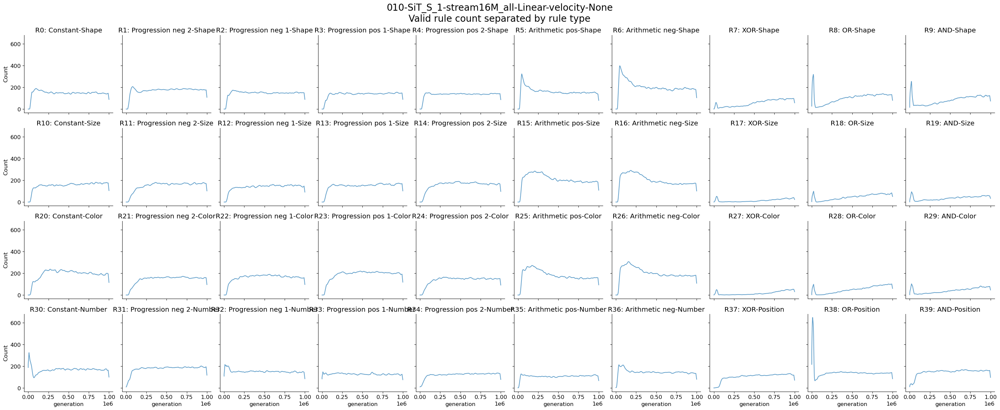

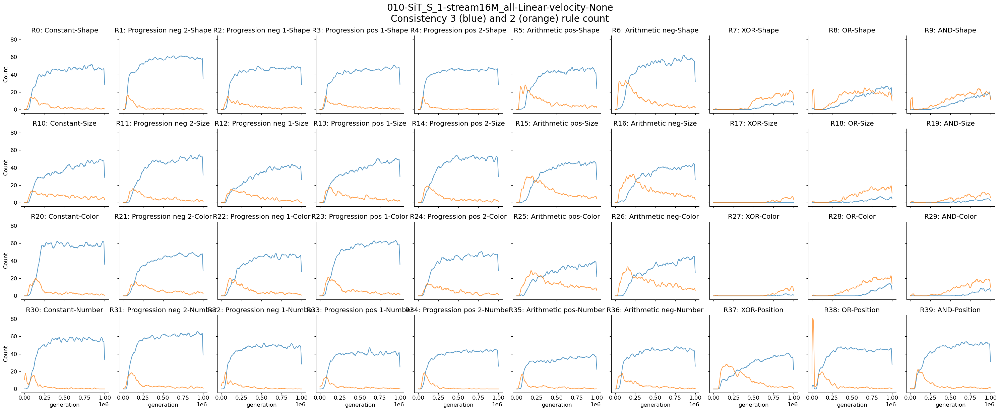

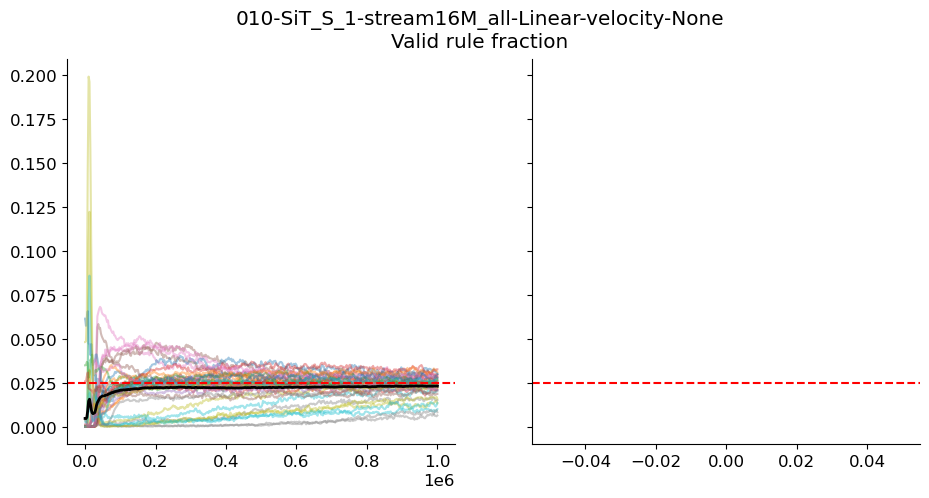

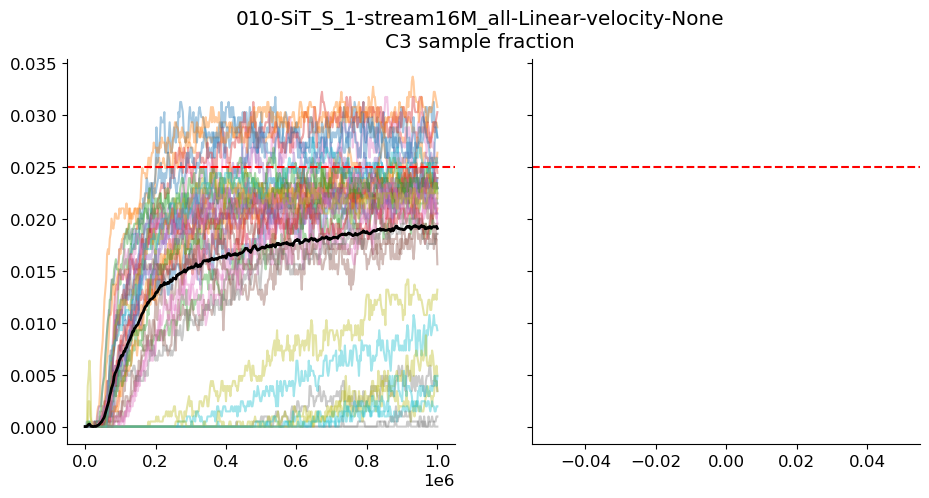

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/011-SiT_B_1-stream0_16M_all-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/379 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(379, 2048, 3) (379, 2, 2048)
011-SiT_B_1-stream0_16M_all-Linear-velocity-None


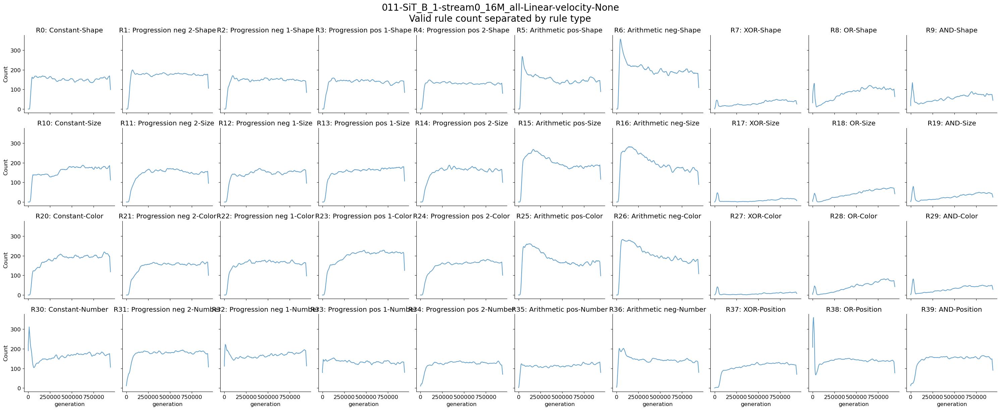

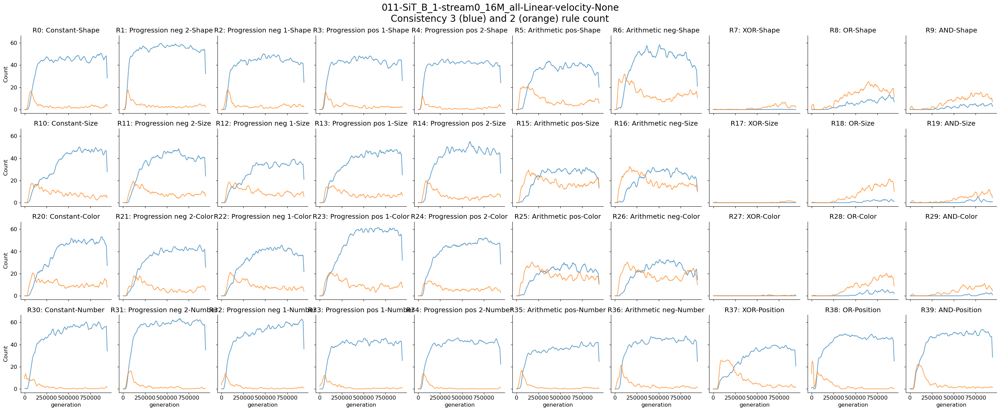

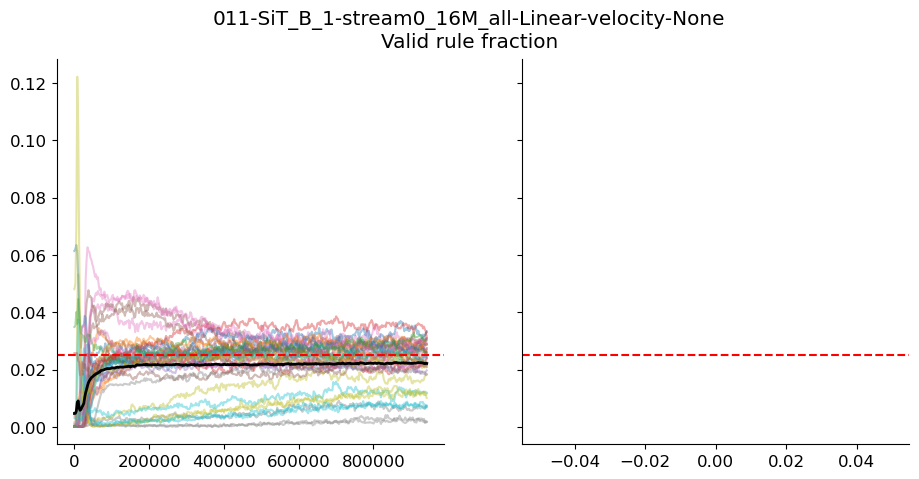

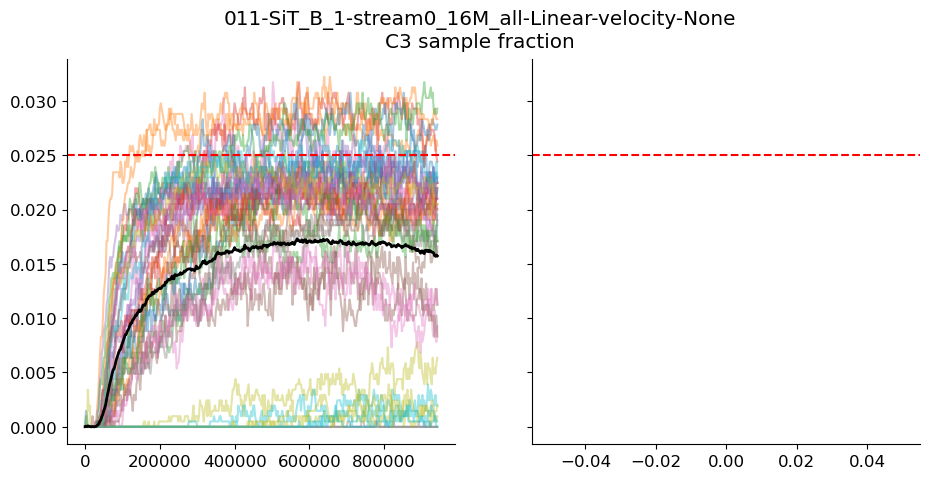

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/011-SiT_S_1-stream16M_heldout0-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/402 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(402, 2048, 3) (402, 2, 2048)
011-SiT_S_1-stream16M_heldout0-Linear-velocity-None


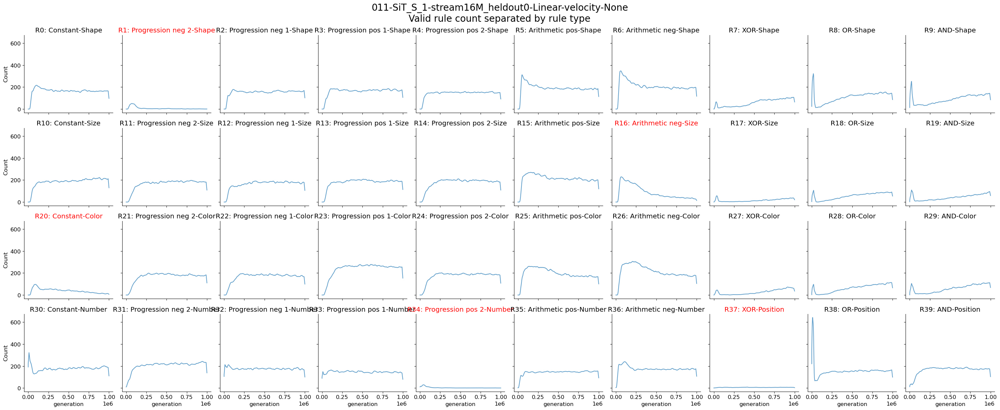

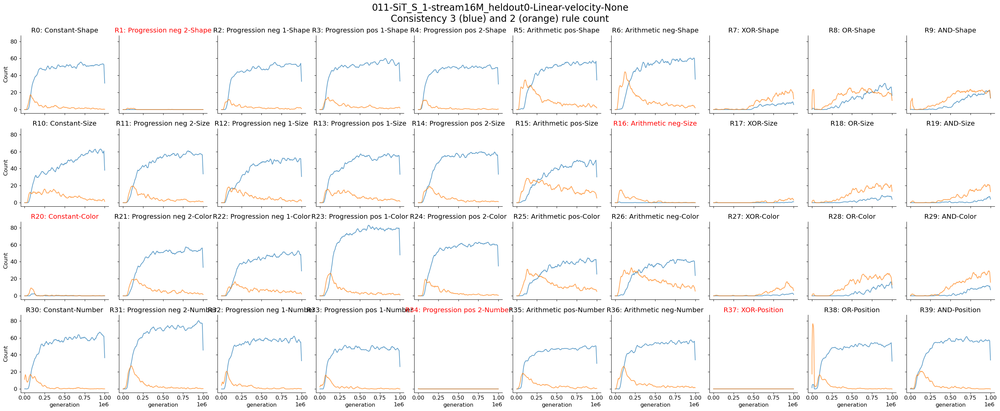

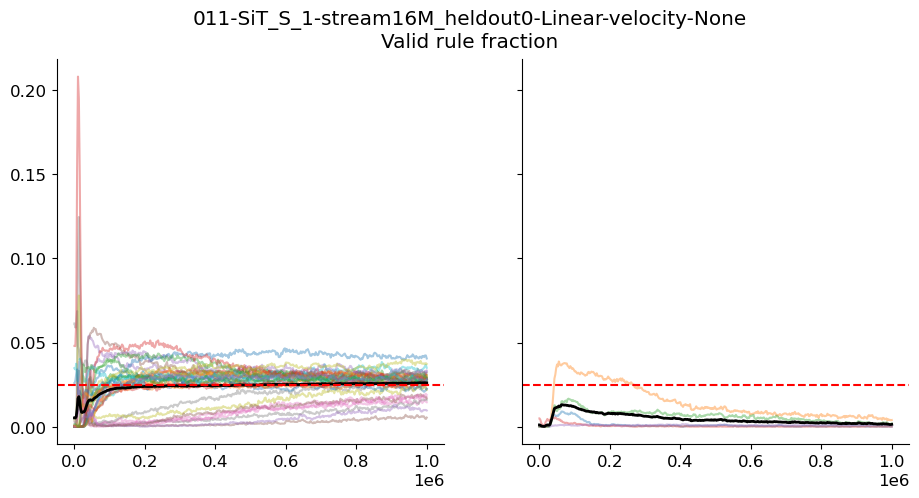

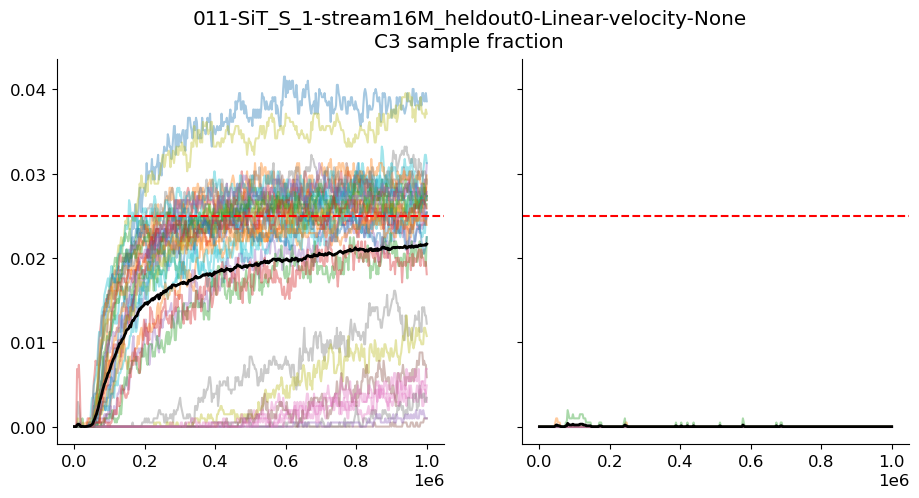

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/012-SiT_B_1-stream0_016M_all-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/328 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(328, 2048, 3) (328, 2, 2048)
012-SiT_B_1-stream0_016M_all-Linear-velocity-None


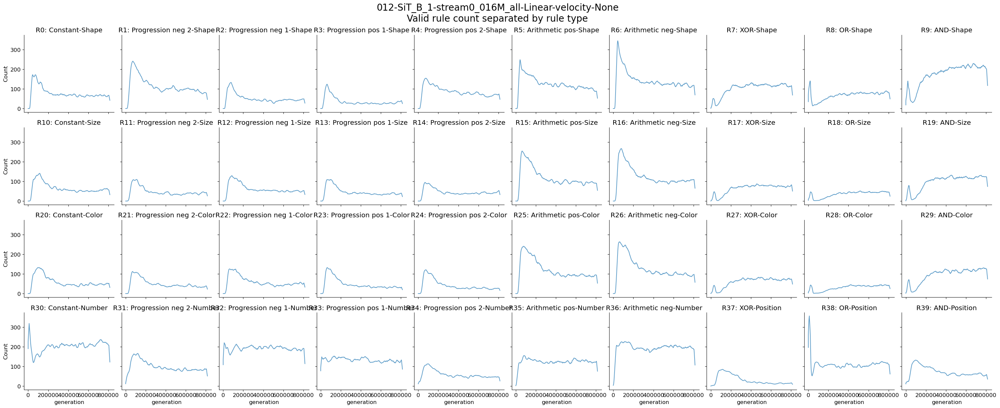

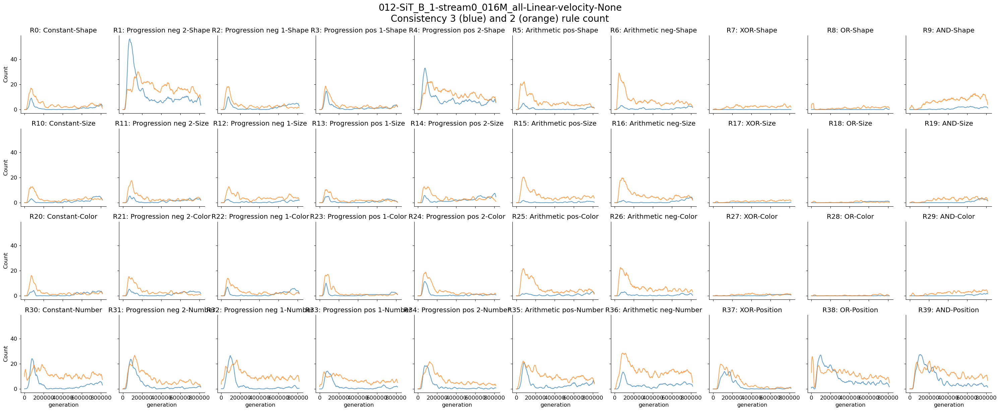

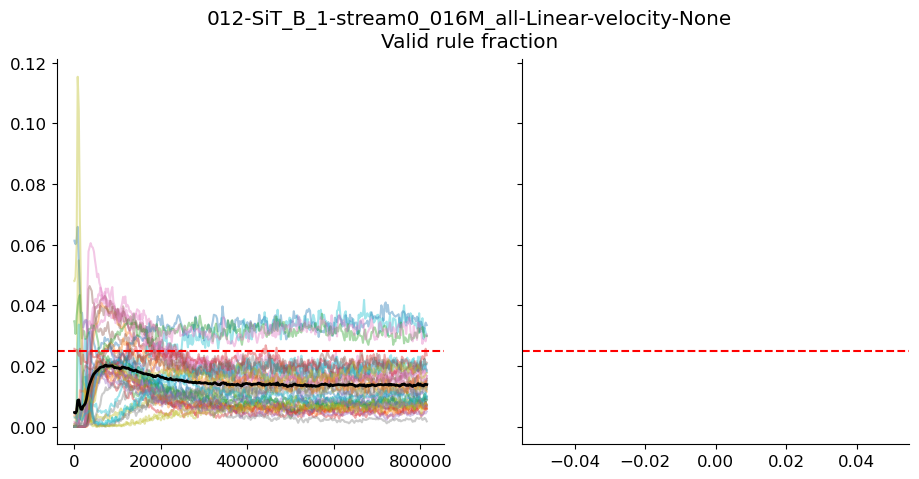

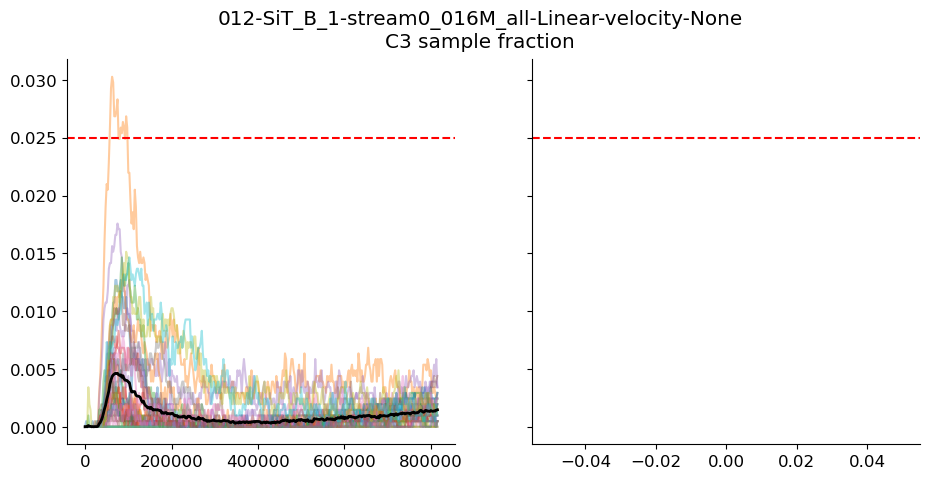

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/012-SiT_S_1-stream1_6M_heldout0-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/402 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(402, 2048, 3) (402, 2, 2048)
012-SiT_S_1-stream1_6M_heldout0-Linear-velocity-None


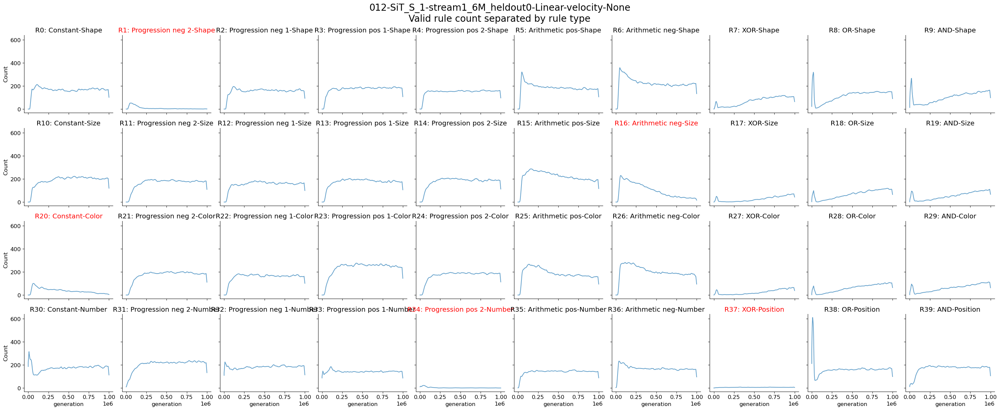

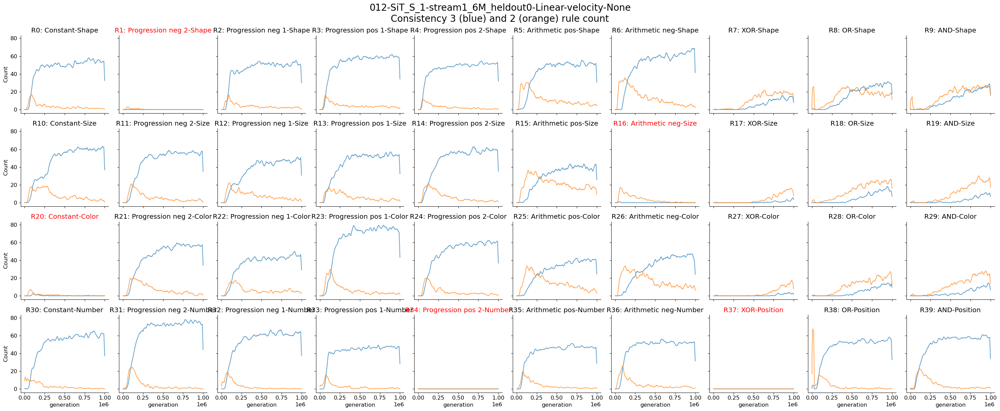

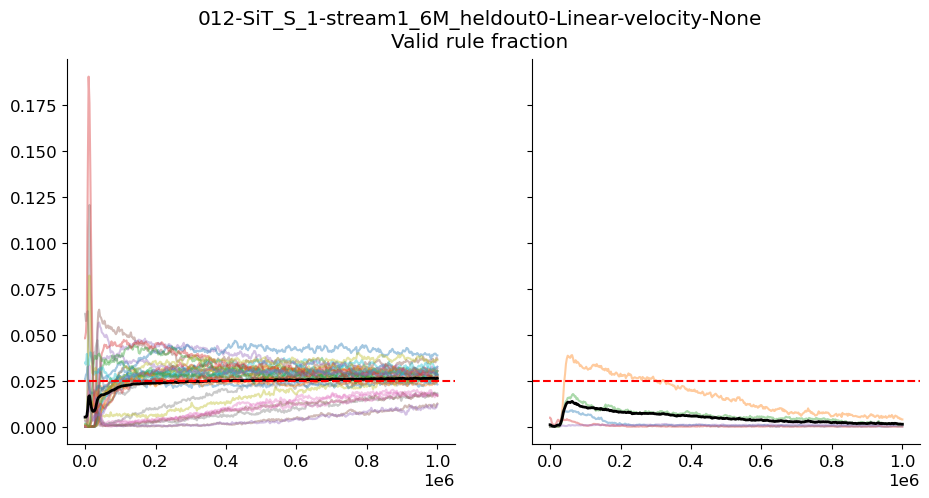

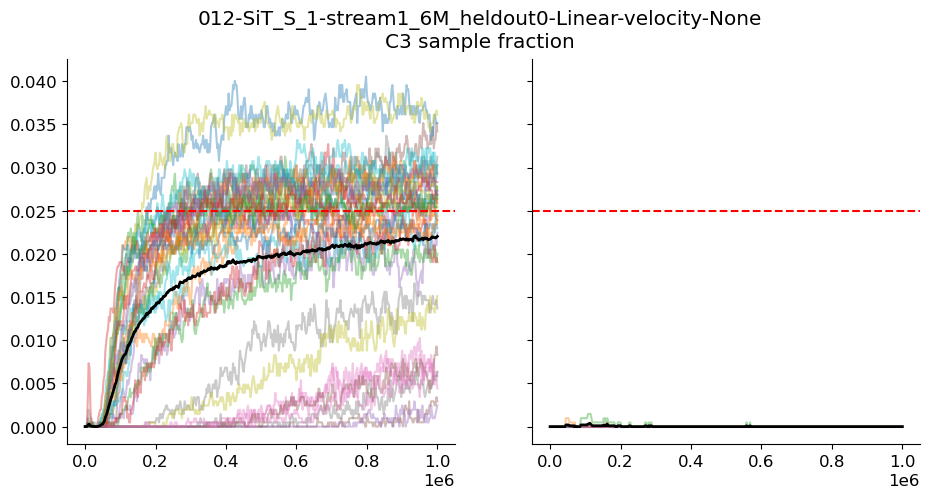

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/013-SiT_B_1-stream16M_all-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/393 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(393, 2048, 3) (393, 2, 2048)
013-SiT_B_1-stream16M_all-Linear-velocity-None


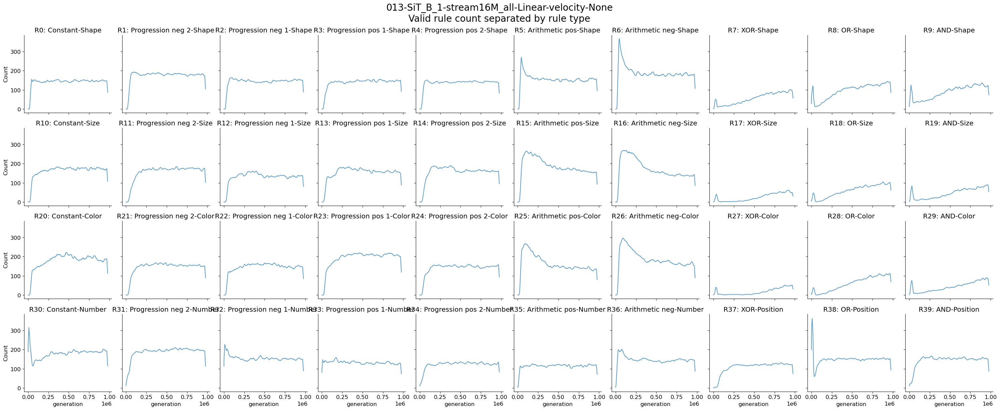

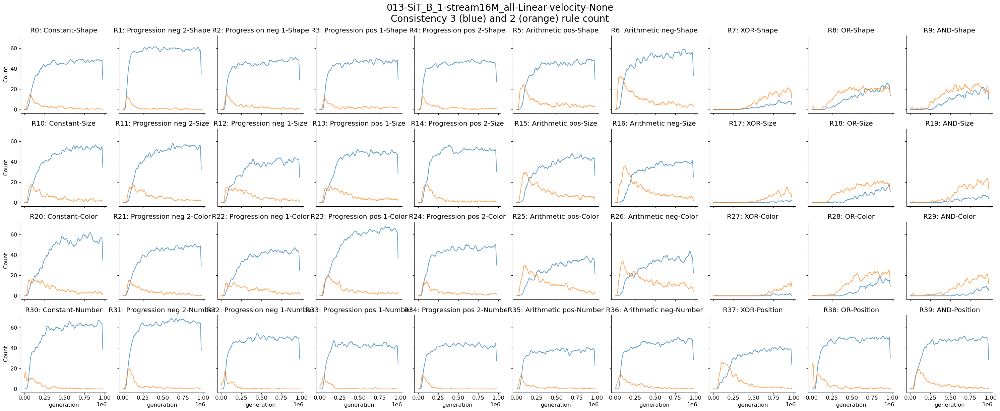

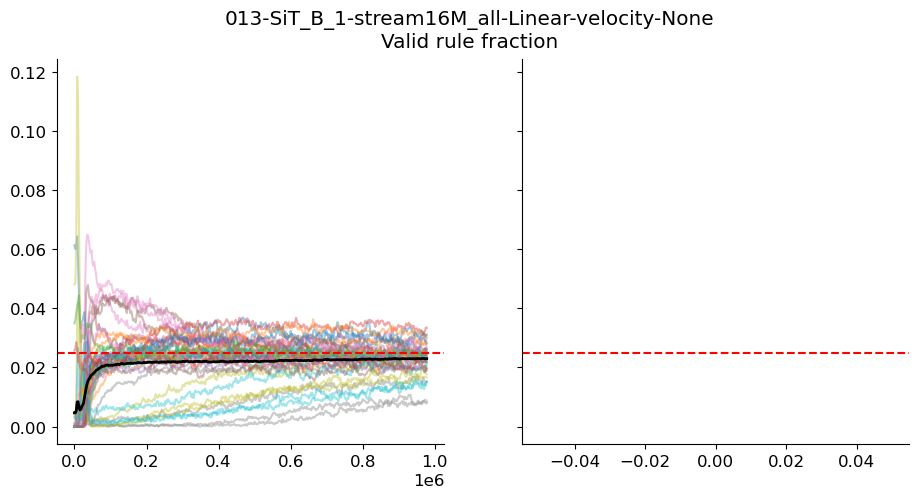

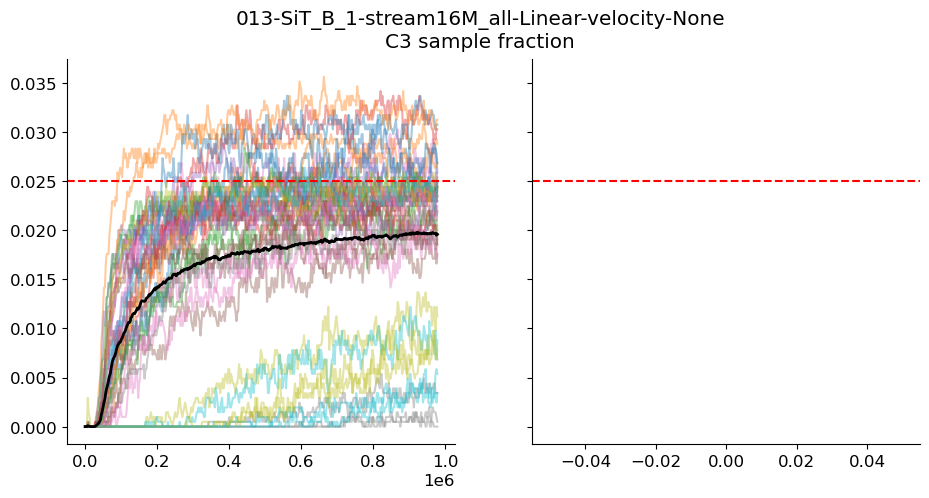

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/013-SiT_S_1-stream0_016M_heldout0-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/402 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(402, 2048, 3) (402, 2, 2048)
013-SiT_S_1-stream0_016M_heldout0-Linear-velocity-None


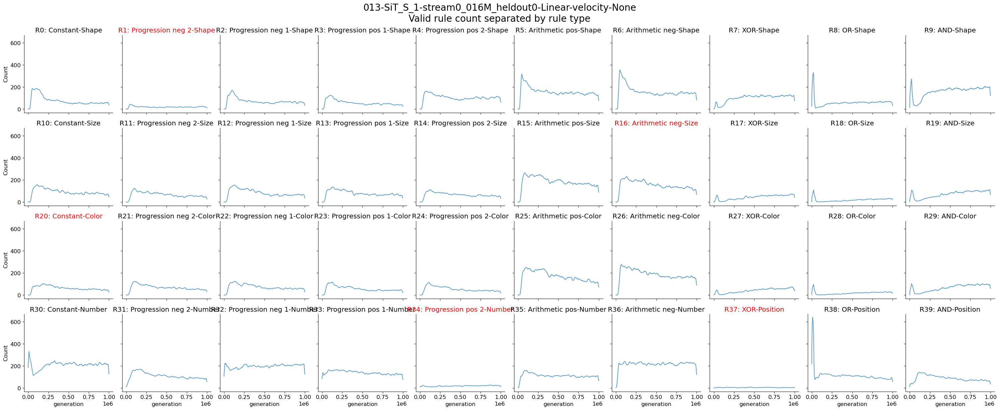

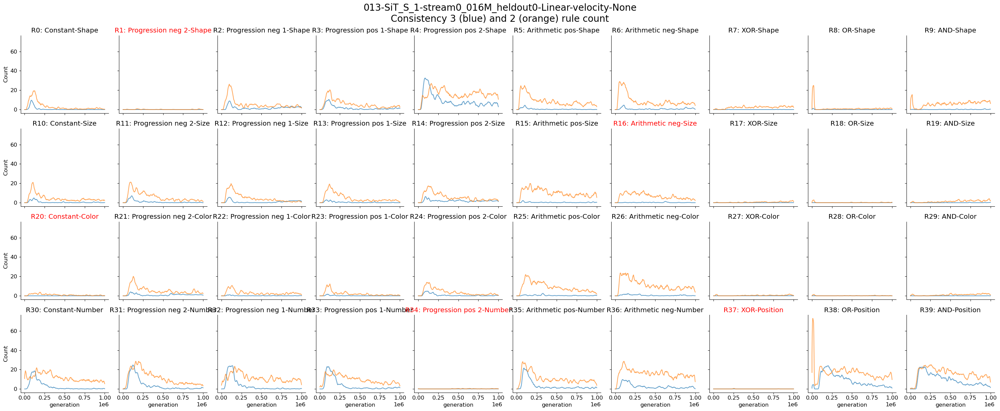

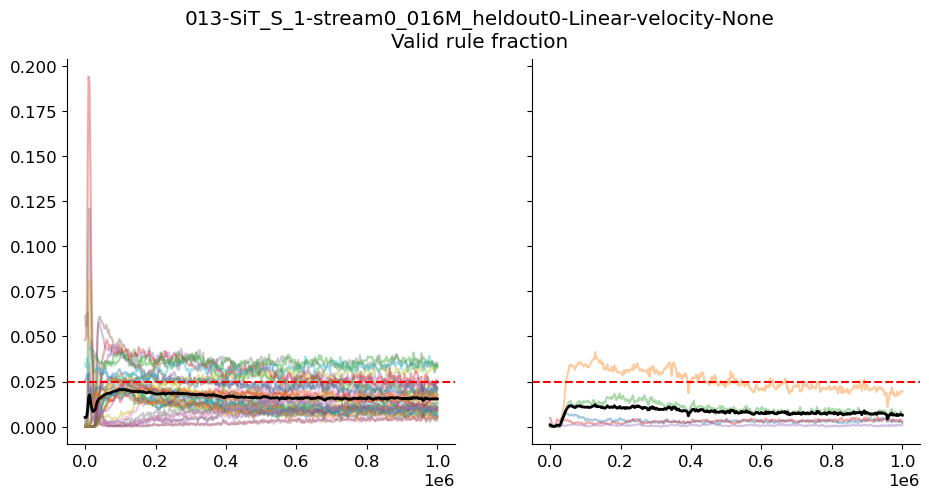

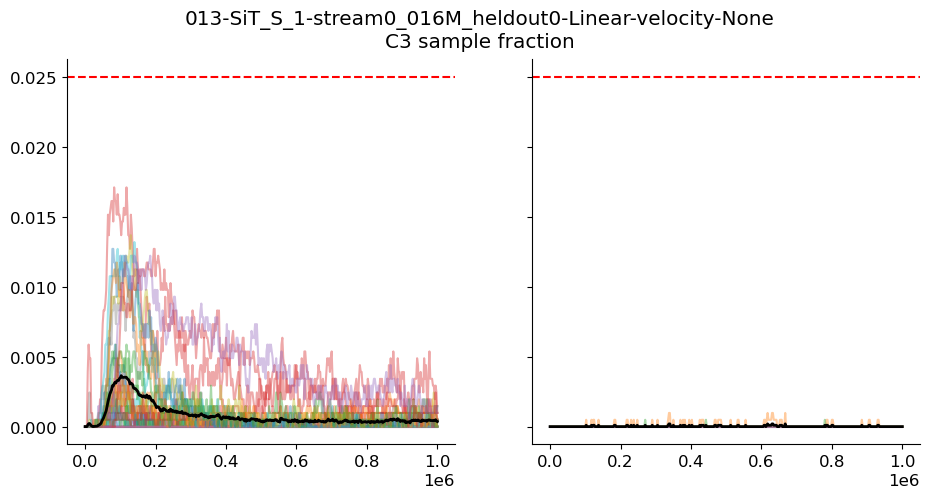

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/014-SiT_B_1-stream1_6M_all-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/392 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(392, 2048, 3) (392, 2, 2048)
014-SiT_B_1-stream1_6M_all-Linear-velocity-None


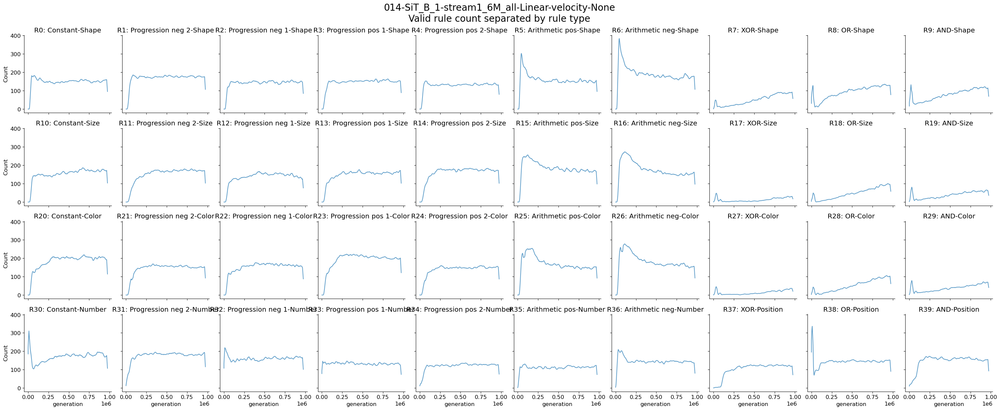

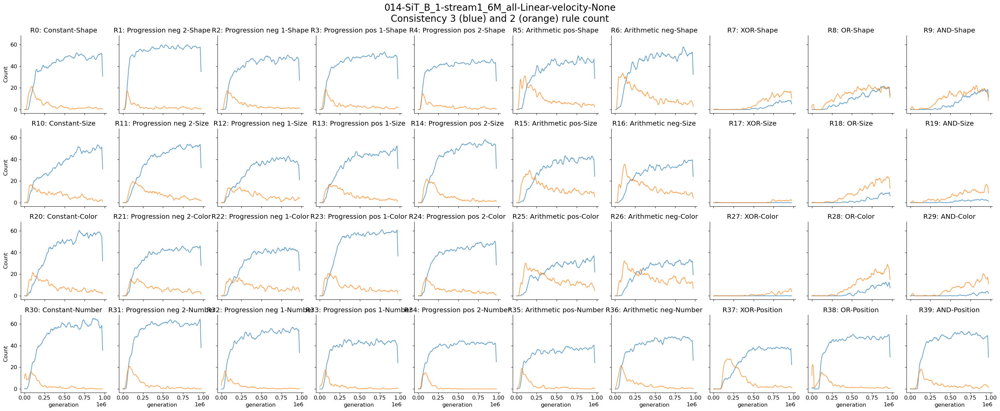

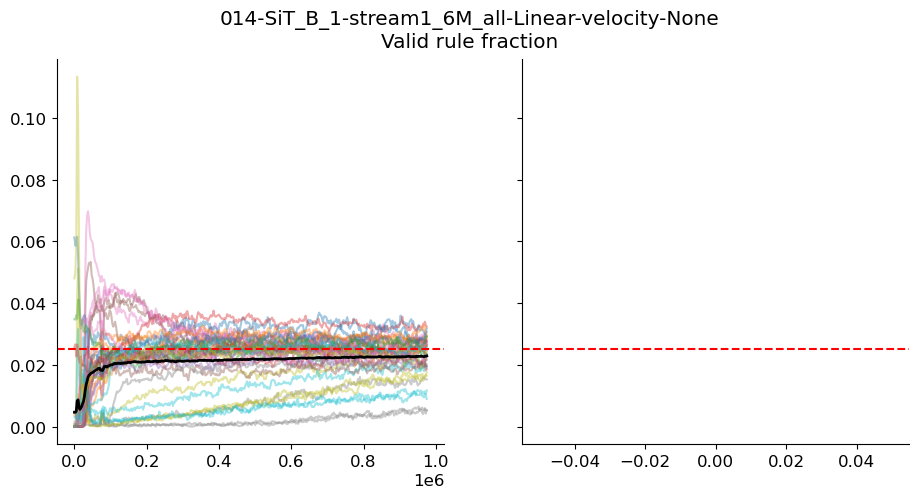

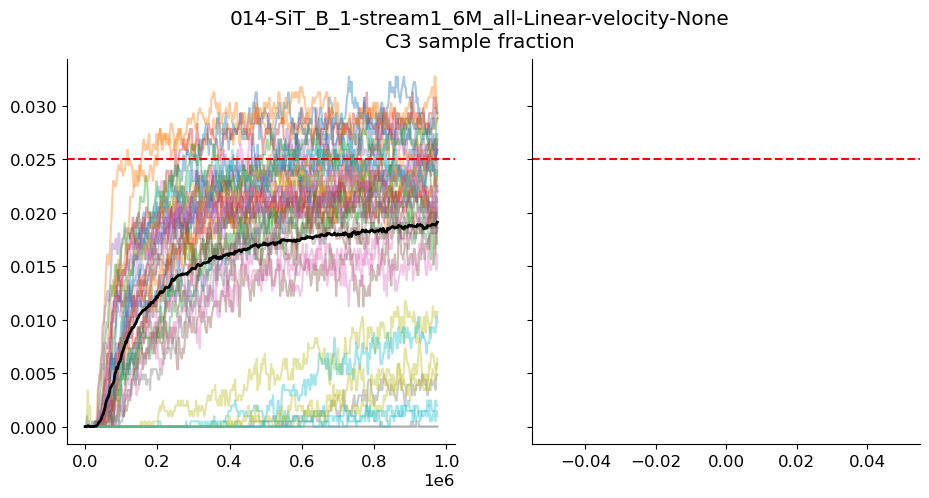

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/014-SiT_S_1-stream0_16M_heldout0-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/402 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(402, 2048, 3) (402, 2, 2048)
014-SiT_S_1-stream0_16M_heldout0-Linear-velocity-None


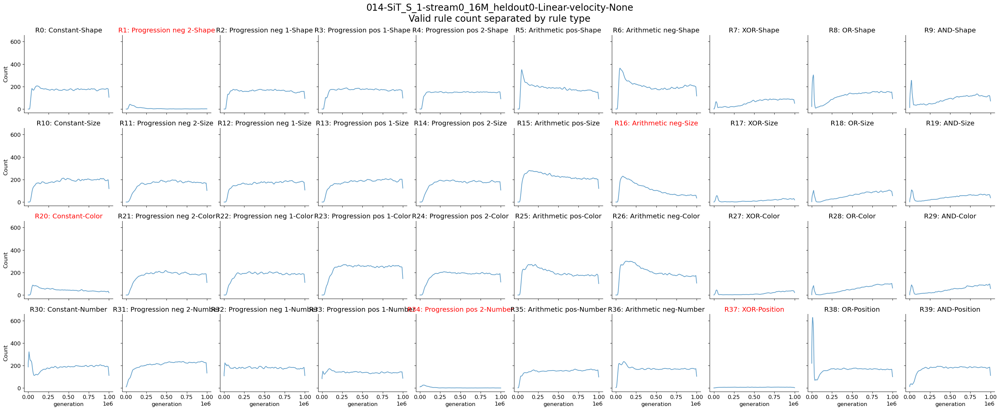

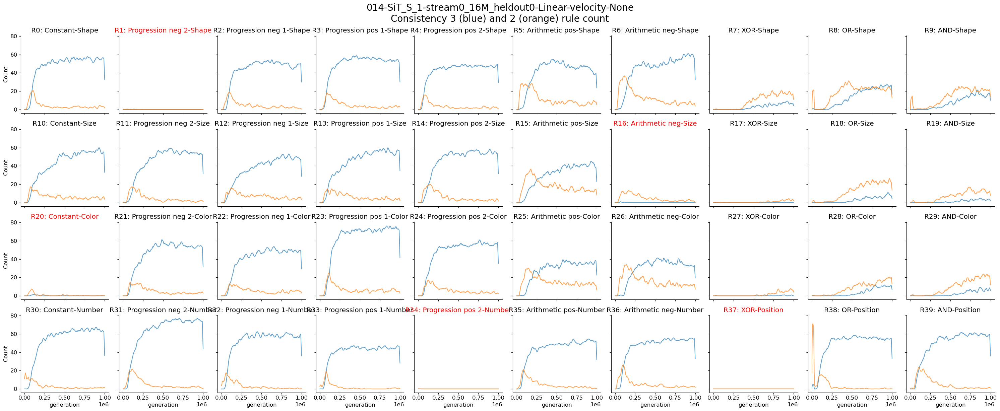

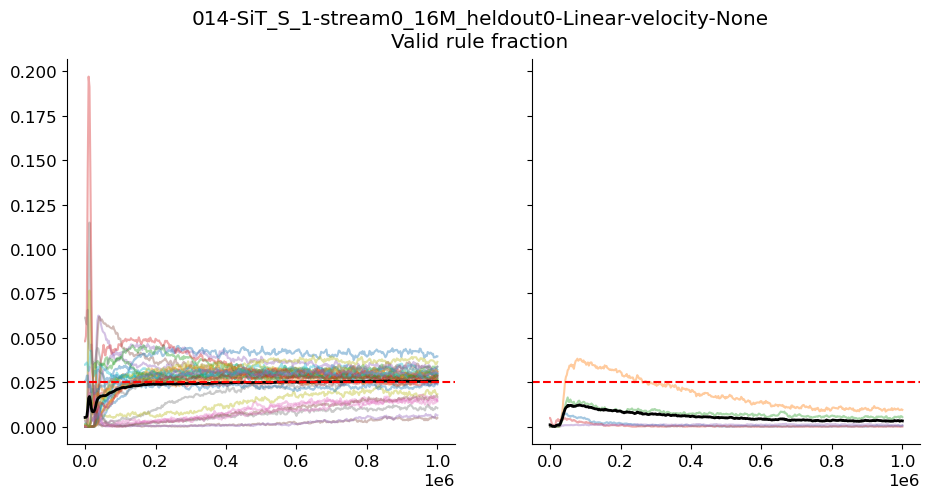

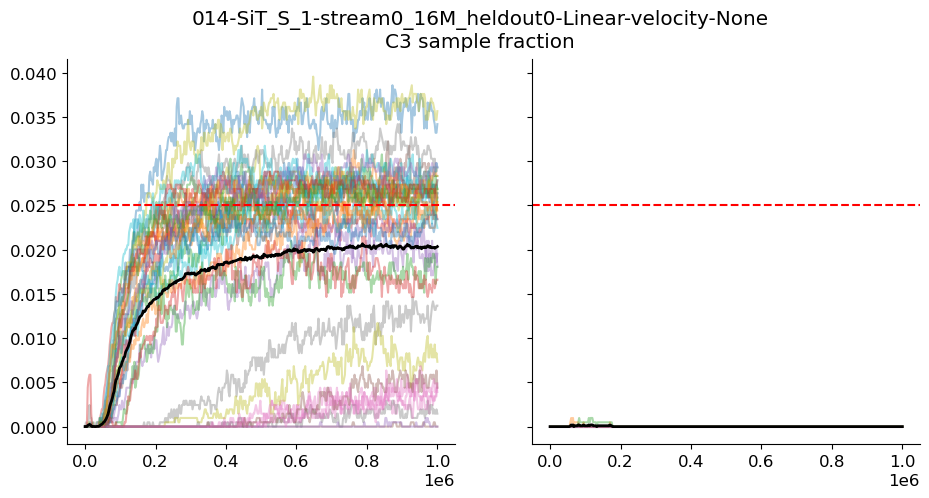

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/015-SiT_B_1-stream0_016M_heldout0-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/402 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(402, 2048, 3) (402, 2, 2048)
015-SiT_B_1-stream0_016M_heldout0-Linear-velocity-None


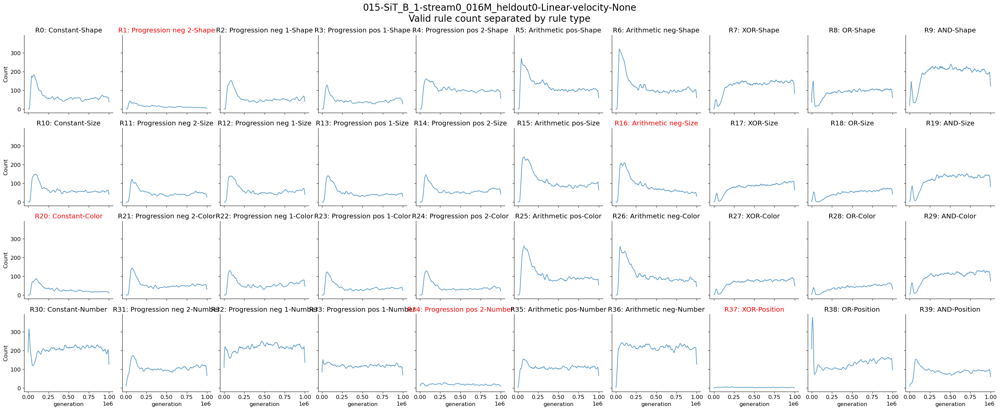

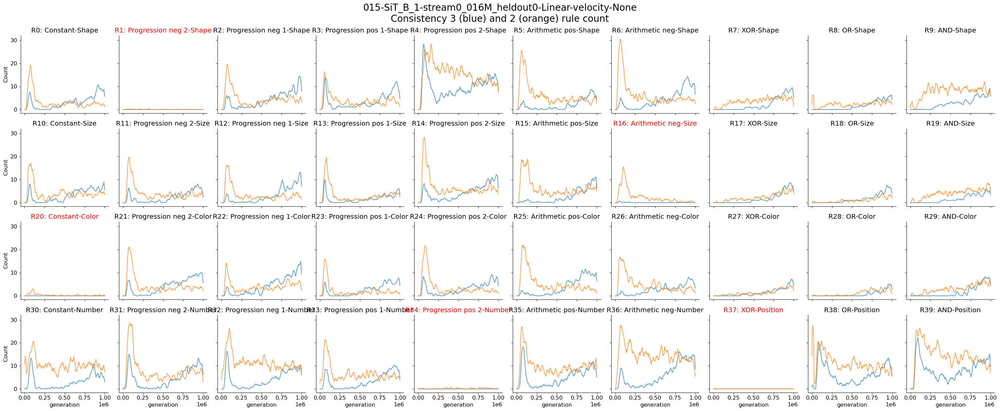

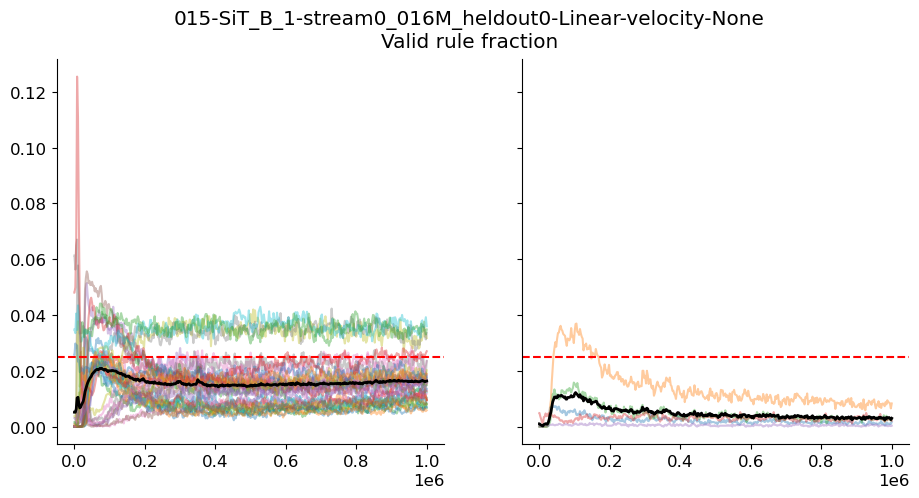

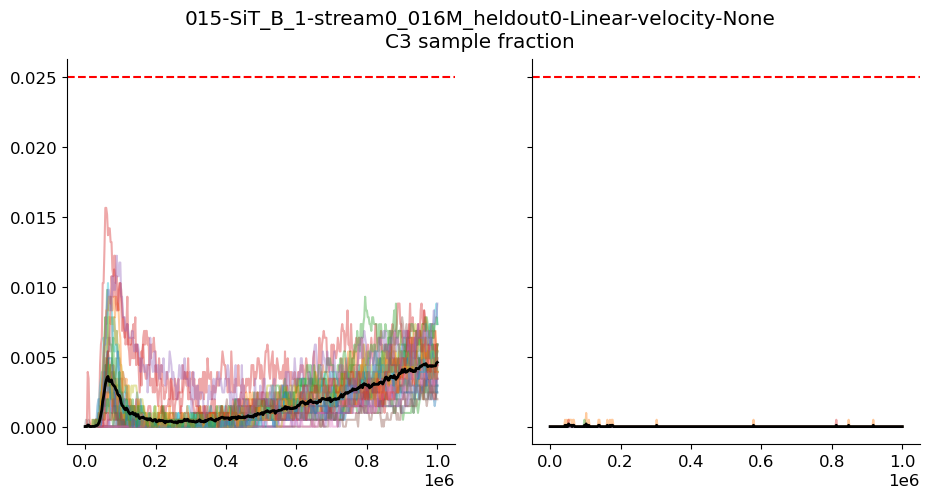

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/016-SiT_B_1-stream16M_heldout0-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/402 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(402, 2048, 3) (402, 2, 2048)
016-SiT_B_1-stream16M_heldout0-Linear-velocity-None


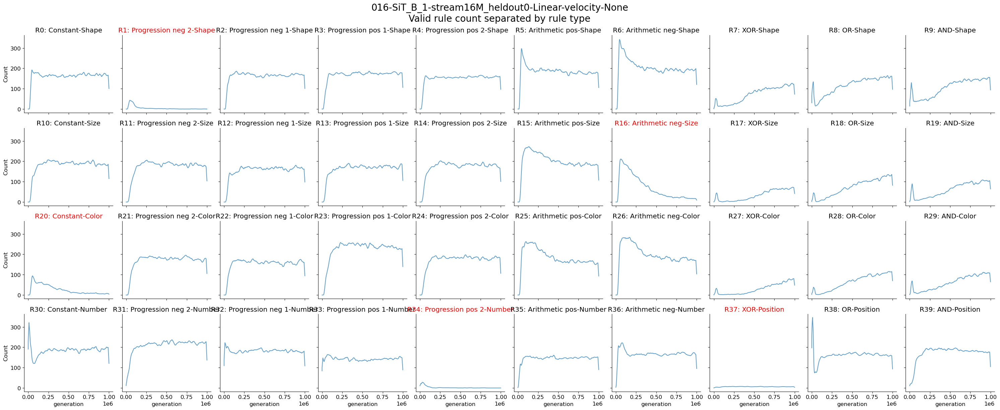

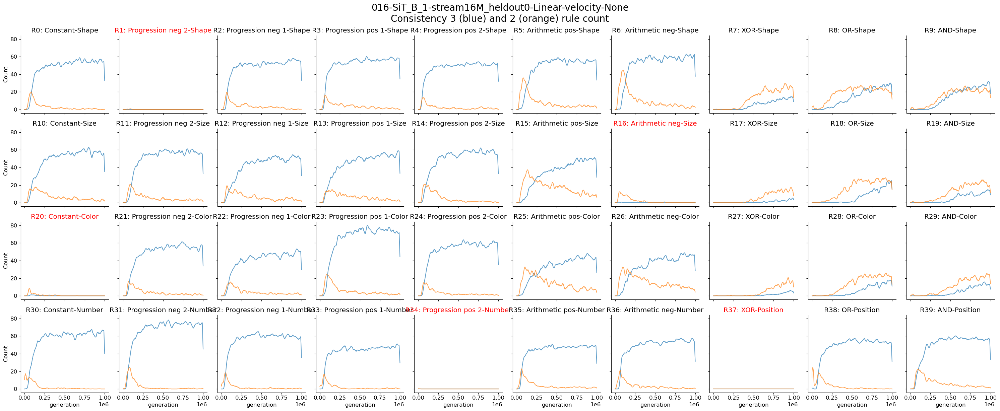

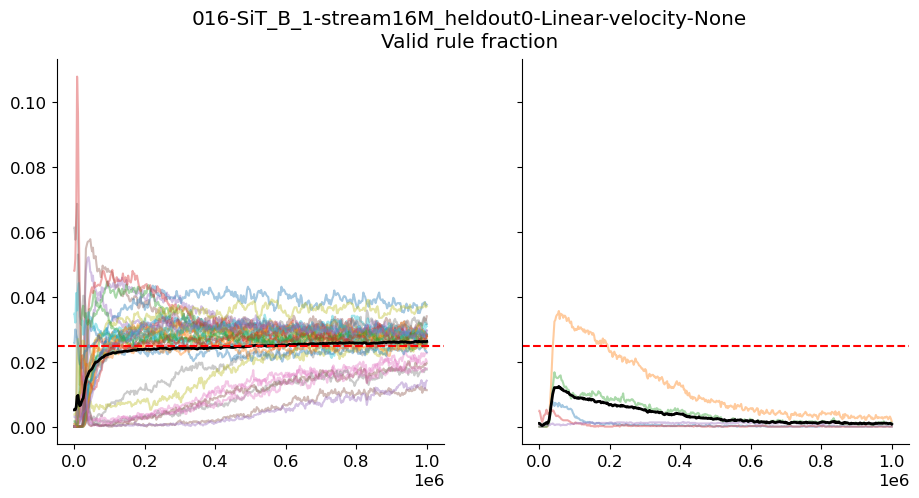

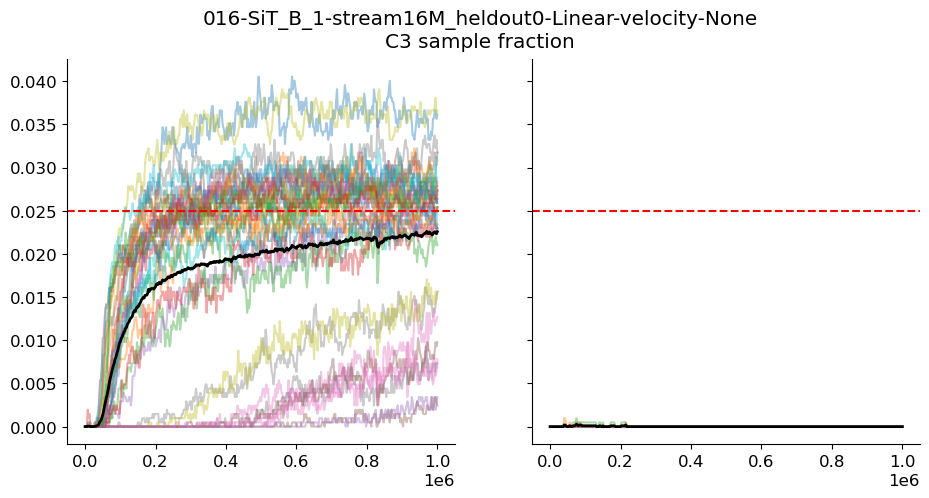

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/017-SiT_B_1-stream0_16M_heldout0-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/402 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(402, 2048, 3) (402, 2, 2048)
017-SiT_B_1-stream0_16M_heldout0-Linear-velocity-None


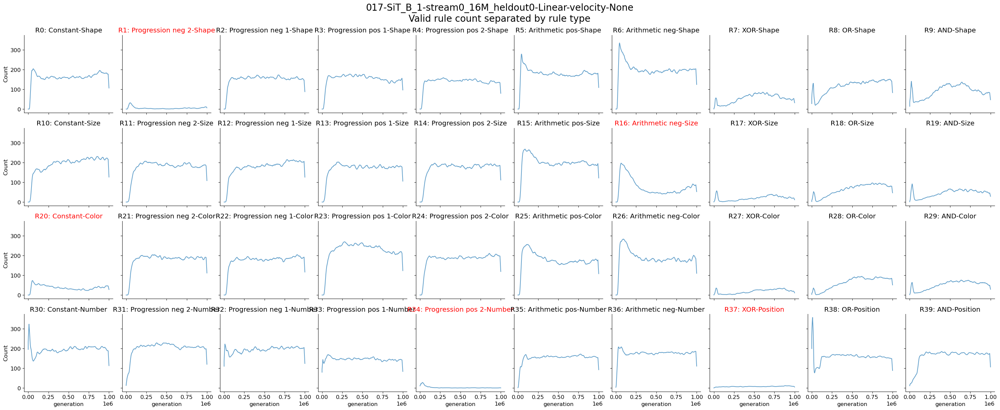

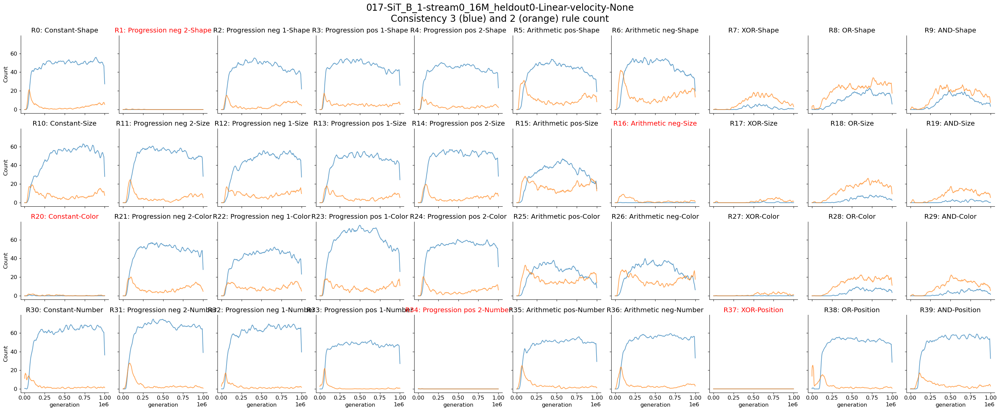

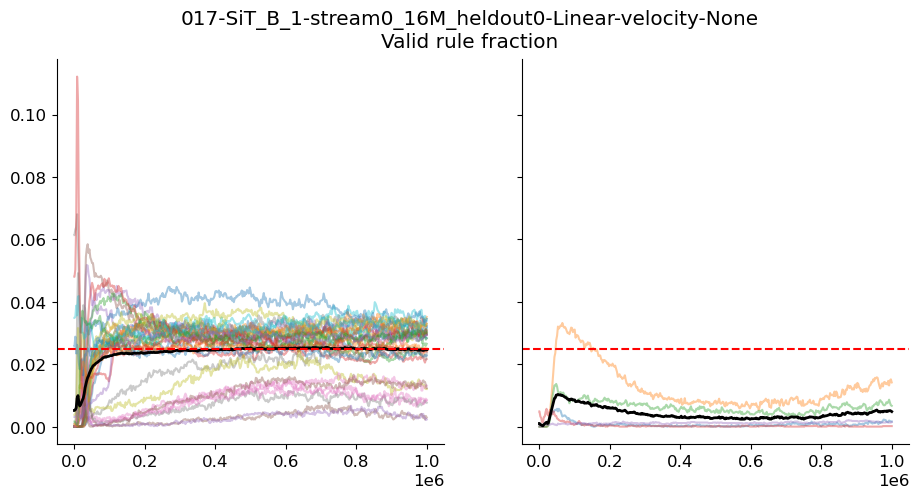

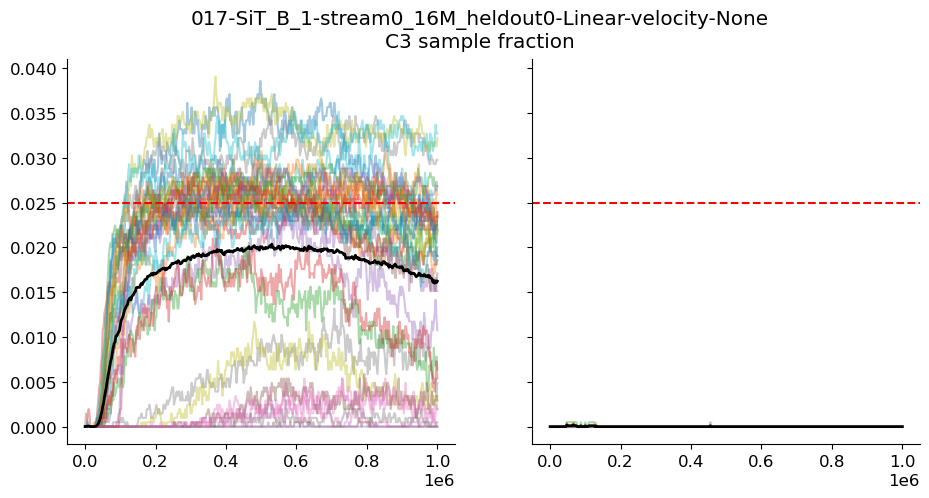

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/SiT/results/018-SiT_B_1-stream1_6M_heldout0-Linear-velocity-None/samples
example file: 0155000.pt


  0%|          | 0/402 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(402, 2048, 3) (402, 2, 2048)
018-SiT_B_1-stream1_6M_heldout0-Linear-velocity-None


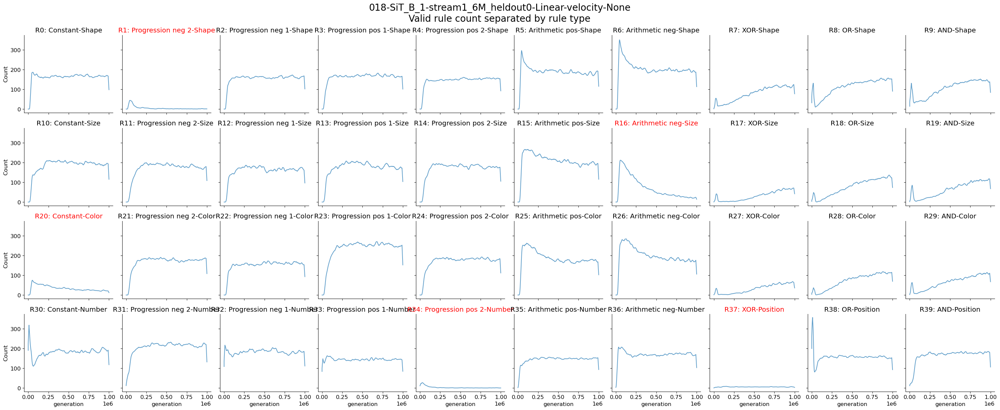

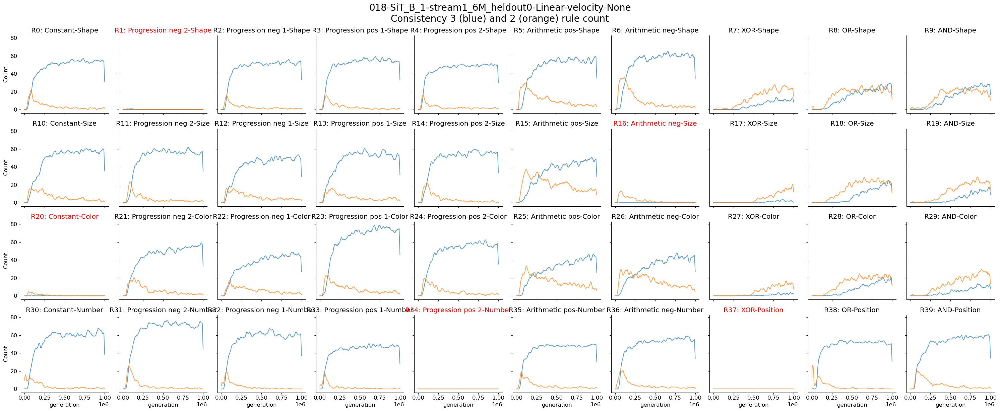

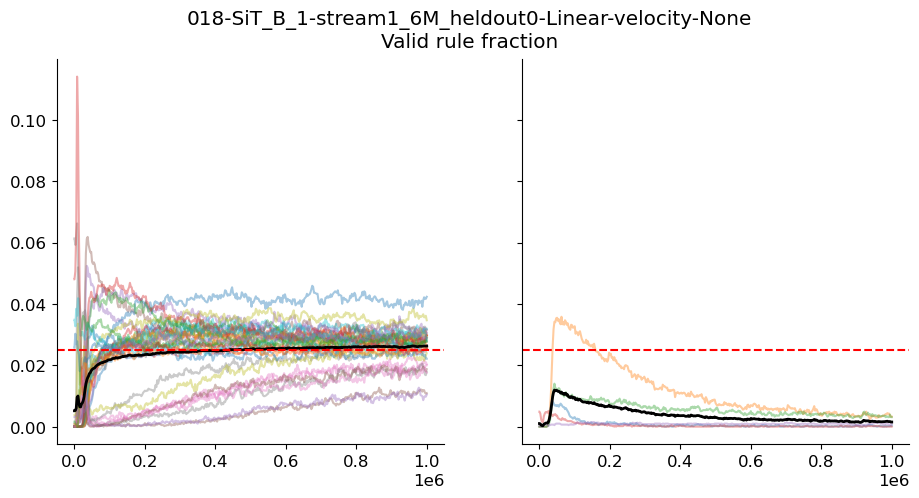

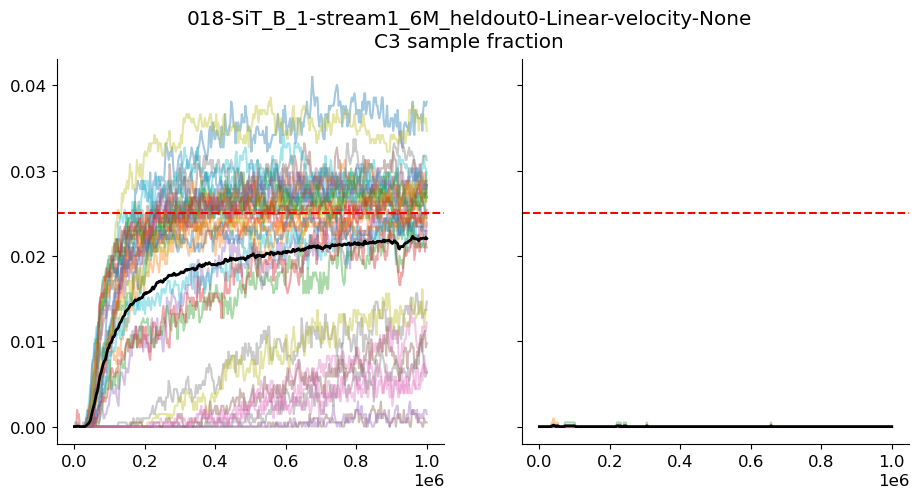

In [17]:
for expfullname in syndf_SiT.full_name:
    tb_record = tb_data_col_SiT[expfullname]
    expname = expfullname.split("/tensorboard_logs")[0]
    prefix = "sample_rule_eval_" #"eval_step" if "stream" in expname else "eval_epoch"
    eval_col = sweep_collect_eval_data(expname, SiT_exproot, prefix=prefix)
    epoch_list, rule_list_all, consistency_all = extract_rule_list_from_eval_col_Diffusion(eval_col, )
    rule_cnt_mat, cons3_rule_cnt_mat, cons2_rule_cnt_mat = format_rule_list_to_mat(rule_list_all, consistency_all)
    eval_sample_num = rule_list_all.shape[1]
    print(expname)
    if "heldout0" in expname:
        heldout_id = [1, 16, 20, 34, 37]  
    else:
        heldout_id = []

    figh, axs = visualize_indiv_rule_dynam(epoch_list, rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                            titlestr=f"{expname}\nValid rule count separated by rule type")
    saveallforms(SiTfigdir, f"{expname}_indiv_rule_validity", figh)

    figh, axs = visualize_indiv_rule_dynam(epoch_list, cons3_rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                                        titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", )
    figh, axs = visualize_indiv_rule_dynam(epoch_list, cons2_rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                                        titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", axs=axs)
    saveallforms(SiTfigdir, f"{expname}_indiv_rule_consistency", figh)
    
    figh = visualize_train_heldout_rule(epoch_list, rule_cnt_mat, heldout_id, 
                                normalizer=eval_sample_num * 3, reflevel=1 / 40,
                                titlestr=f"{expname}\nValid rule fraction")
    saveallforms(EDMfigdir, f"{expname}_train_held_rule_validity", figh)

    figh = visualize_train_heldout_rule(epoch_list, cons3_rule_cnt_mat, heldout_id, 
                                normalizer=eval_sample_num, reflevel=1 / 40,
                                titlestr=f"{expname}\nC3 sample fraction")
    saveallforms(SiTfigdir, f"{expname}_train_held_rule_consistency", figh)
    # raise ValueError("stop here")